# TD2C-D2C, ideas for different MBs (notebook for comparison)
This notebook wants to compare different formulations of `TD2C` method, each of them with a different way of computing the MB:

MB formulations:

1. **Past MB**: Classic TD2C's MB but considering a bigger lag in the past for the variables under exam. Ex: we want to discoveer the causal path X^(t-1)_i -> X_j and normally we would consider X_i^(t-1), X_i^(t), X_i^(t+1) and X_j^(t-1), X_j^(t), X_j^(t+1) but here we ho back in the past and try to include also  X_i^(t-2), X_i^(t-3), X_i^(t-4) and X_j^(t-2), X_j^(t-3), X_j^(t-4) in X_i and X_j's MBs. 
This is done by setting the `past_lag` parameter in the `D2C` class.

2. **TD2C-D2C MIX**: We combine TD2C's MB with a preliminary ranking of the variables as was done in D2C, trying to reduce the computational cost of D2C and maybe find a better balance for the curse of dimentionality.

3. **MBMB**: D2C's MB but enlarged, including the most relevat variables for the most relevant variables for X_i and X_j.


With this notebook you'll be able to generate the data, generate the decriptors for each of the MB formulations, obtain a classification result and plot the results for comparison.


# Settings

## Packages

In [1]:
import pandas as pd
from tqdm import tqdm
from multiprocessing import Pool
import pickle 
import os
import numpy as np
import matplotlib.pyplot as plt

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, balanced_accuracy_score
from sklearn.ensemble import RandomForestClassifier
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.metrics import roc_auc_score

from d2c.data_generation.builder import TSBuilder
from d2c.descriptors_generation import D2C, DataLoader
from d2c.benchmark import D2CWrapper

## Parameters setting

In [2]:
N_JOBS = 40 # number of jobs to run in parallel. For D2C, parallelism is implemented at the observation level: each observation from a single file is processed in parallel
SEED = 42 # random seed for reproducibility
MB_SIZE = 2 # size to consider when estimating the markov blanket. This is only useful if the MB is actually estimated
COUPLES_TO_CONSIDER_PER_DAG = 60 # edges that are considered in total to compute descriptors, for each TS. This can speed up the process. If set to -1, all possible edges are considered
maxlags = 5 # maximum lags to consider when considering variable couples

# Data Generation
Data are generated with the `TSBuilder` class and saved in a specific folder. Then, the code checks for missing datasets in the folder and keeps running untill all the possible combinations of parameters have genereted a dataset.

In [11]:
# SET THE TSBUILDER WITH THE DESIRED PARAMETERS
def run_process(params):
    """
    Run a single process of the data generation.
    """
    process, n_variables, max_neighborhood_size, noise_std = params
    try:
        tsbuilder = TSBuilder(observations_per_time_series=250, 
                              maxlags=5, 
                              n_variables=n_variables, 
                              time_series_per_process=40, 
                              processes_to_use=[process], 
                              noise_std=noise_std, 
                              max_neighborhood_size=max_neighborhood_size, 
                              seed=42, 
                              max_attempts=200,
                              verbose=True)

        tsbuilder.build()
        tsbuilder.to_pickle(f'/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/P{process}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}.pkl')
        print(f'P{process}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std} done')
    except ValueError as e:
        print(f'P{process}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std} failed: {e}')

# BUILD THE DATA
if __name__ == '__main__':
    """
    This script generates the data for different parameters: processes, number of variables, neighborhood sizes and noise levels.
    The data is saved in the .data folder.
    The if __name__ == '__main__': is used to avoid multiprocessing issues in Jupyter notebooks, i.e. the script is run as a script and not
    as a module as it would have been if the script was imported, with the __name__ being the name of the module.
    If the script is imported, the __name__ is the name of the module, if it is run as a script, the __name__ is __main__.
    So, to run this script in a Jupyter notebook, we write the code inside the if __name__ == '__main__': block, while, if we want to import
    the functions from this script, we write "from script import run_process".
    """
    parameters = [(process, n_variables, max_neighborhood_size, noise_std)
                    for process in [1, 2, 3, 4, 6, 7, 8, 9] # , 10, 11, 12, 13, 14, 15, 16, 18, 19, 20
                    for n_variables in [5] # , 10, 25
                    for max_neighborhood_size in [2] # , 4, 8
                    for noise_std in [0.01]] # , 0.005, 0.001

    with Pool(processes=N_JOBS) as pool:
        pool.map(run_process, parameters)


# Function to check for missing files
def check_missing_files():
    missing = []
    for process in [1, 2, 3, 4, 6, 7, 8, 9]:  # , 10, 11, 12, 13, 14, 15, 16, 18, 19, 20
        for n_variables in [5]:  # , 10, 25
            for max_neighborhood_size in [2]:  # , 4, 8
                for noise_std in [0.01]:  # , 0.005, 0.001
                    filename = f'/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/P{process}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}.pkl'
                    if not os.path.exists(filename):
                        missing.append(filename)
    return missing

# Function to run the process
def run_process(params):
    process, n_variables, max_neighborhood_size, noise_std = params
    try:  # we change the seed and increase the max_attempts
        tsbuilder = TSBuilder(observations_per_time_series=250, 
                              maxlags=5, 
                              n_variables=n_variables, 
                              time_series_per_process=40, 
                              processes_to_use=[process], 
                              noise_std=noise_std, 
                              max_neighborhood_size=max_neighborhood_size, 
                              seed=24, 
                              max_attempts=400,
                              verbose=True)

        tsbuilder.build()
        tsbuilder.to_pickle(f'/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/P{process}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}.pkl')
        print(f'P{process}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std} done')
    except ValueError as e:
        print(f'P{process}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std} failed: {e}')

# CHECK FOR MISSING FILES (IT CHEKS THE FILES WITH A DIFFERENT SEED AND MORE MAX_ATTEMPTS UNTILL MISSING IS EMPTY)
if __name__ == '__main__':
    while True:
        missing = check_missing_files()
        if not missing:
            break

        parameters = []
        for missing_file in missing:
            process = int(missing_file.split('/')[-1].split('_')[0][1:])
            n_variables = int(missing_file.split('/')[-1].split('_')[1][1:])
            max_neighborhood_size = int(missing_file.split('/')[-1].split('_')[2][2:])
            noise_std = float(missing_file.split('/')[-1].split('_')[3][1:-4])
            parameters.append((process, n_variables, max_neighborhood_size, noise_std))

        with Pool(processes=N_JOBS) as pool:
            pool.map(run_process, parameters)

len(os.listdir('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data'))


P3_N5_Nj2_n0.01 done
P4_N5_Nj2_n0.01 done
P9_N5_Nj2_n0.01 done
P8_N5_Nj2_n0.01 done
P6_N5_Nj2_n0.01 done
P2_N5_Nj2_n0.01 done
P1_N5_Nj2_n0.01 done
P7_N5_Nj2_n0.01 done


18

# Descriptors Generation & Classification

## Regression Estimation of MI

### D2C (& D2C but without contemporaneous nodes) 

#### Descriptors Generation

In [3]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/D2C/'  

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='original',
            mb_estimator= 'original',
            top_vars=3)

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

  0%|          | 0/18 [00:00<?, ?it/s]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

  6%|▌         | 1/18 [00:07<02:09,  7.59s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 11%|█         | 2/18 [00:14<01:59,  7.48s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 17%|█▋        | 3/18 [00:25<02:11,  8.79s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)



Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: 

 22%|██▏       | 4/18 [00:36<02:13,  9.55s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: 

 28%|██▊       | 5/18 [01:08<03:51, 17.80s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 33%|███▎      | 6/18 [01:15<02:50, 14.22s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 39%|███▉      | 7/18 [01:23<02:14, 12.22s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)



Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)



Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (2

 44%|████▍     | 8/18 [01:31<01:48, 10.89s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: 

 50%|█████     | 9/18 [02:05<02:40, 17.84s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y:

 56%|█████▌    | 10/18 [02:16<02:08, 16.00s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)




Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: 

 61%|██████    | 11/18 [02:24<01:33, 13.41s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: 

 67%|██████▋   | 12/18 [02:36<01:18, 13.07s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)



Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (24

 72%|███████▏  | 13/18 [03:09<01:34, 18.90s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)




Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: 

 78%|███████▊  | 14/18 [03:22<01:08, 17.10s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 83%|████████▎ | 15/18 [03:32<00:45, 15.11s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (2

 89%|████████▉ | 16/18 [03:44<00:28, 14.32s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)





Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (24

 94%|█████████▍| 17/18 [04:16<00:19, 19.55s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

100%|██████████| 18/18 [04:29<00:00, 14.98s/it]


#### Run Classifier

In [4]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []
descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/D2C/'

# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [5]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file

for n_vars, todo in todos.items():
    d2c_rocs_process = {}
    d2c_precision_process = {}
    d2c_recall_process = {}
    d2c_f1_process = {}
    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        d2c_rocs_process[gen_process_number] = rocs
        d2c_precision_process[gen_process_number] = precisions
        d2c_recall_process[gen_process_number] = recalls
        d2c_f1_process[gen_process_number] = f1s

  0%|          | 0/18 [00:00<?, ?it/s]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/my

#### Save Results

In [6]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_d2c_R_N5.pkl'), 'wb') as f:
    everything = (d2c_rocs_process, d2c_precision_process, d2c_recall_process, d2c_f1_process)
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N10.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N25.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Plot

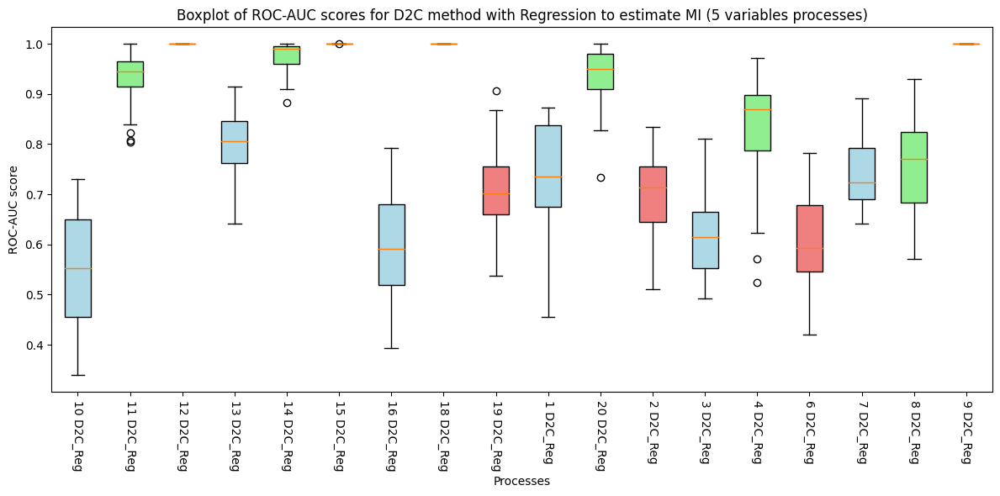

In [4]:
#################################################################### LOAD DATA #####################################################################
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

with open(os.path.join(input_folder, 'journal_results_d2c_R_N5.pkl'), 'rb') as f:
    D2C_rocs_process, D2C_precision_process, D2C_recall_process, D2C_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)


##################################################################### PLOT #########################################################################

df1 = pd.DataFrame(D2C_rocs_process)

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} D2C_Reg')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Boxplot of ROC-AUC scores for D2C method with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

### TD2C (& TD2C but without contrmporaneous nodes)

#### Descriptors Generation

In [5]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C/'  

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='original',
            mb_estimator= 'ts',
            top_vars=3)

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

100%|██████████| 18/18 [01:25<00:00,  4.77s/it]


#### Run Classifier

In [6]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []
descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C/'

# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [7]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file

for n_vars, todo in todos.items():
    td2c_rocs_process = {}
    td2c_precision_process = {}
    td2c_recall_process = {}
    td2c_f1_process = {}
    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        td2c_rocs_process[gen_process_number] = rocs
        td2c_precision_process[gen_process_number] = precisions
        td2c_recall_process[gen_process_number] = recalls
        td2c_f1_process[gen_process_number] = f1s

  0%|          | 0/18 [00:00<?, ?it/s]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/my

#### Save Results

In [8]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_td2c_R_N5.pkl'), 'wb') as f:
    everything = (td2c_rocs_process, td2c_precision_process, td2c_recall_process, td2c_f1_process)
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_td2c_R_N10.pkl'), 'wb') as f:
#     everything = (td2c_R_rocs_process, td2c_R_precision_process, td2c_R_recall_process, td2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_td2c_R_N25.pkl'), 'wb') as f:
#     everything = (td2c_R_rocs_process, td2c_R_precision_process, td2c_R_recall_process, td2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Plot

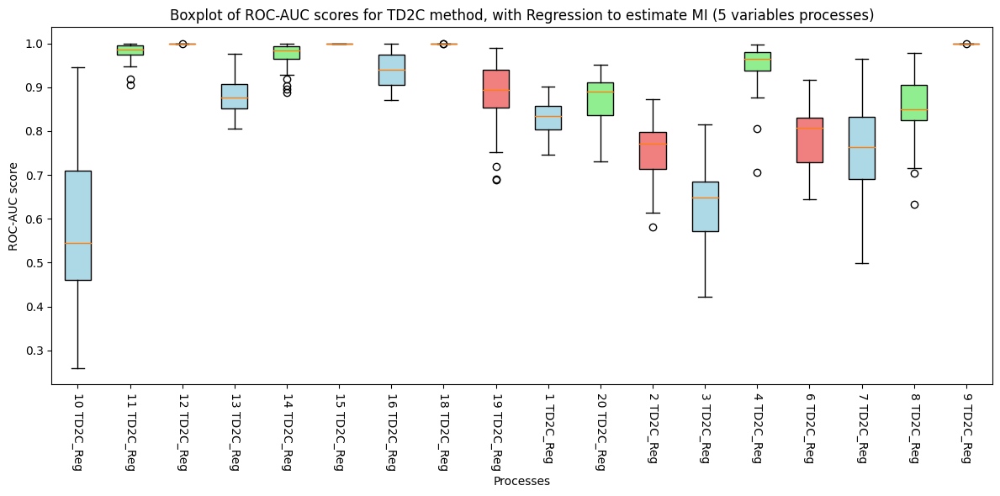

In [5]:
#################################################################### LOAD DATA #####################################################################
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

with open(os.path.join(input_folder, 'journal_results_td2c_R_N5.pkl'), 'rb') as f:
    TD2C_rocs_process, TD2C_precision_process, TD2C_recall_process, TD2C_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)


##################################################################### PLOT #########################################################################

df1 = pd.DataFrame(TD2C_rocs_process)

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} TD2C_Reg')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Boxplot of ROC-AUC scores for TD2C method, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

### TD2C + Ranking (All methods)

#### Descriptors Generation

In [6]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################

# SET FOLDER
cartella = 8
# 1 = TD2C_+Ranking_1
# 2 = TD2C_+Ranking_2
# 3 = TD2C_+Ranking_3, 
# 4 = TD2C_+Ranking_NoCont
# 11 = TD2C_+Ranking_1 with two variables from ranking 
# 111 = TD2C_+Ranking_1 with three variables from ranking
# 110 = TD2C_+Ranking_1 with ten variables from ranking
# 5 = TD2C_+Ranking_4 with one variable from ranking
# 6 = TD2C_+Ranking_5 with one variable from ranking
# 7 = TD2C_+Ranking_6 with one variable from ranking
# 8 = TD2C_+Ranking_7 with one variable from ranking

if cartella == 1:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/1_Var/' 
    ts_rank = 'ts_rank'
    vars_to_keep = 1
elif cartella == 11:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/2_Var/'
    ts_rank = 'ts_rank'
    vars_to_keep = 2
elif cartella == 111:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/3_Var/'
    ts_rank = 'ts_rank'
    vars_to_keep = 3
elif cartella == 110:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/10_Var/'
    ts_rank = 'ts_rank'
    vars_to_keep = 10
elif cartella == 2:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_2/'
    ts_rank = 'ts_rank_2'
    vars_to_keep = 1
elif cartella == 3:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_3/'
    ts_rank = 'ts_rank_3'
    vars_to_keep = 1
elif cartella == 4:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_NoCont/'
    ts_rank = 'ts_rank_no_cont' 
    vars_to_keep = 1
elif cartella == 5:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_4/'
    ts_rank = 'ts_rank_4' 
    vars_to_keep = 1
elif cartella == 6:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_5/'
    ts_rank = 'ts_rank_5' 
    vars_to_keep = 1
elif cartella == 7:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_6/'
    ts_rank = 'ts_rank_6' 
    vars_to_keep = 1
elif cartella == 8:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_7/'
    ts_rank = 'ts_rank_7' 
    vars_to_keep = 1

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='original',
            mb_estimator= ts_rank,
            top_vars = vars_to_keep)

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

  0%|          | 0/18 [00:00<?, ?it/s]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

  6%|▌         | 1/18 [00:27<07:43, 27.24s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y:

 11%|█         | 2/18 [00:52<06:57, 26.07s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)




Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y:

 17%|█▋        | 3/18 [01:25<07:15, 29.01s/it]

Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 22%|██▏       | 4/18 [01:57<07:07, 30.53s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y:

 28%|██▊       | 5/18 [02:24<06:20, 29.31s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)


Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 33%|███▎      | 6/18 [02:48<05:29, 27.46s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 39%|███▉      | 7/18 [03:12<04:48, 26.24s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 44%|████▍     | 8/18 [03:36<04:15, 25.55s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 50%|█████     | 9/18 [04:02<03:50, 25.64s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 56%|█████▌    | 10/18 [04:37<03:47, 28.50s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)


Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 61%|██████    | 11/18 [05:01<03:10, 27.27s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 67%|██████▋   | 12/18 [05:40<03:03, 30.62s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)



Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 72%|███████▏  | 13/18 [06:12<02:35, 31.09s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 78%|███████▊  | 14/18 [06:44<02:05, 31.36s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y:

 83%|████████▎ | 15/18 [07:19<01:37, 32.58s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)



Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)


Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)



Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 89%|████████▉ | 16/18 [07:51<01:04, 32.29s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 94%|█████████▍| 17/18 [08:23<00:32, 32.28s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

100%|██████████| 18/18 [08:56<00:00, 29.83s/it]


#### Run Classifier

In [7]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []

# TAKES THE FOLDER SET AT THE STEP BEFORE AND RUN ALL THE FOLLOWING CELLS FOR THIS METHOD
# 1 = TD2C_+Ranking_1
# 2 = TD2C_+Ranking_2
# 3 = TD2C_+Ranking_3
# 4 = TD2C_+Ranking_NoCont
# 11 = TD2C_+Ranking_1 with two variables from ranking 
# 111 = TD2C_+Ranking_1 with three variables from ranking
# 110 = TD2C_+Ranking_1 with ten variables from ranking
# 5 = TD2C_+Ranking_4 with two variables from ranking
# 6 = TD2C_+Ranking_5 with three variables from ranking

if cartella == 1:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/1_Var/' 
    name = 'TD2C_Ranking_1_1_Var'
elif cartella == 11:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/2_Var/'
    name = 'TD2C_Ranking_1_2_Var'
elif cartella == 111:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/3_Var/'
    name = 'TD2C_Ranking_1_3_Var'
elif cartella == 110:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_1/10_Var/'
    name = 'TD2C_Ranking_1_10_Var'
elif cartella == 2:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_2/'
    name = 'TD2C_Ranking_2'
elif cartella == 3:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C_+Ranking_3/'
    name = 'TD2C_Ranking_3'
elif cartella == 4:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_NoCont/'
    name = 'TD2C_Ranking_NoCont'
elif cartella == 5:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_4/'
    name = 'TD2C_Ranking_4'
elif cartella == 6:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_5/'
    name = 'TD2C_Ranking_5'
elif cartella == 7:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_6/'
    name = 'TD2C_Ranking_6'
elif cartella == 8:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_+Ranking/TD2C+Ranking_7/'
    name = 'TD2C_Ranking_7'



# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [8]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file


for n_vars, todo in todos.items():
    m1 = f'{name}_rocs_process'
    m2 = f'{name}_precision_process'
    m3 = f'{name}_recall_process'
    m4 = f'{name}_f1_process'

    globals()[m1] = {}
    globals()[m2] = {}
    globals()[m3] = {}
    globals()[m4] = {}


    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        globals()[m1][gen_process_number] = rocs
        globals()[m2][gen_process_number] = precisions
        globals()[m3][gen_process_number] = recalls
        globals()[m4][gen_process_number] = f1s

  0%|          | 0/18 [00:00<?, ?it/s]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/my

#### Save Results

In [9]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_{name}_N5.pkl'), 'wb') as f:
    everything = (globals()[m1], globals()[m2], globals()[m3], globals()[m4])
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N10.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N25.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Load data for local and global plots

##### local save

In [10]:
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

# LOCAL
with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
    globals()[m1], globals()[m2], globals()[m3], globals()[m4] = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

##### global save

In [16]:
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

cartella = 8

if cartella == 1:
    name = 'TD2C_Ranking_1_1_Var'
elif cartella == 11:
    name = 'TD2C_Ranking_1_2_Var'
elif cartella == 111:
    name = 'TD2C_Ranking_1_3_Var'
elif cartella == 110:
    name = 'TD2C_Ranking_1_10_Var'
elif cartella == 2:
    name = 'TD2C_Ranking_2'
elif cartella == 3:
    name = 'TD2C_Ranking_3'
elif cartella == 4:
    name = 'TD2C_Ranking_NoCont'
elif cartella == 5:
    name = 'TD2C_Ranking_4'
elif cartella == 6:
    name = 'TD2C_Ranking_5'
elif cartella == 7:
    name = 'TD2C_Ranking_6'
elif cartella == 8:
    name = 'TD2C_Ranking_7'

if cartella == 1:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_1_Var_rocs_process, TD2C_Ranking_1_1_Var_precision_process, TD2C_Ranking_1_1_Var_recall_process, TD2C_Ranking_1_1_Var_f1_process = pickle.load(f)
elif cartella == 11:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_2_Var_rocs_process, TD2C_Ranking_1_2_Var_precision_process, TD2C_Ranking_1_2_Var_recall_process, TD2C_Ranking_1_2_Var_f1_process = pickle.load(f)
elif cartella == 111:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_3_Var_rocs_process, TD2C_Ranking_1_3_Var_precision_process, TD2C_Ranking_1_3_Var_recall_process, TD2C_Ranking_1_3_Var_f1_process = pickle.load(f)
elif cartella == 110:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_10_Var_rocs_process, TD2C_Ranking_1_10_Var_precision_process, TD2C_Ranking_1_10_Var_recall_process, TD2C_Ranking_1_10_Var_f1_process = pickle.load(f)
elif cartella == 2:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_2_rocs_process, TD2C_Ranking_2_precision_process, TD2C_Ranking_2_recall_process, TD2C_Ranking_2_f1_process = pickle.load(f)
elif cartella == 3:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_3_rocs_process, TD2C_Ranking_3_precision_process, TD2C_Ranking_3_recall_process, TD2C_Ranking_3_f1_process = pickle.load(f)
elif cartella == 4:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_NoCont_rocs_process, TD2C_Ranking_NoCont_precision_process, TD2C_Ranking_NoCont_recall_process, TD2C_Ranking_NoCont_f1_process = pickle.load(f)
elif cartella == 5:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_4_rocs_process, TD2C_Ranking_4_precision_process, TD2C_Ranking_4_recall_process, TD2C_Ranking_4_f1_process = pickle.load(f)
elif cartella == 6:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_5_rocs_process, TD2C_Ranking_5_precision_process, TD2C_Ranking_5_recall_process, TD2C_Ranking_5_f1_process = pickle.load(f)
elif cartella == 7:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_6_rocs_process, TD2C_Ranking_6_precision_process, TD2C_Ranking_6_recall_process, TD2C_Ranking_6_f1_process = pickle.load(f)
elif cartella == 8:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_7_rocs_process, TD2C_Ranking_7_precision_process, TD2C_Ranking_7_recall_process, TD2C_Ranking_7_f1_process = pickle.load(f)

#### Plot

In [17]:
df1 = pd.DataFrame(globals()[m1])
df_name = f'{name}_rocs_dataset'
globals()[df_name] = df1

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} {name}')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title(f'Boxplot of ROC-AUC scores for {name} method, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

NameError: name 'm1' is not defined

### TD2C in the past-future (& TD2C in the past-future but without contrmporaneous nodes)

#### Descriptors Generation

In [19]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_PastFut/'  

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='original',
            mb_estimator= 'ts_past')

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

100%|██████████| 18/18 [04:44<00:00, 15.79s/it]


#### Run Classifier

In [37]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []
descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/Regression/TD2C_PastFut/'

# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [38]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file

for n_vars, todo in todos.items():
    td2c_past_rocs_process = {}
    td2c_past_precision_process = {}
    td2c_past_recall_process = {}
    td2c_past_f1_process = {}
    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        td2c_past_rocs_process[gen_process_number] = rocs
        td2c_past_precision_process[gen_process_number] = precisions
        td2c_past_recall_process[gen_process_number] = recalls
        td2c_past_f1_process[gen_process_number] = f1s

  0%|          | 0/18 [00:00<?, ?it/s]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/my

#### Save Results

In [39]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_td2c_past_R_N5.pkl'), 'wb') as f:
    everything = (td2c_past_rocs_process, td2c_past_precision_process, td2c_past_recall_process, td2c_past_f1_process)
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N10.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N25.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Plot

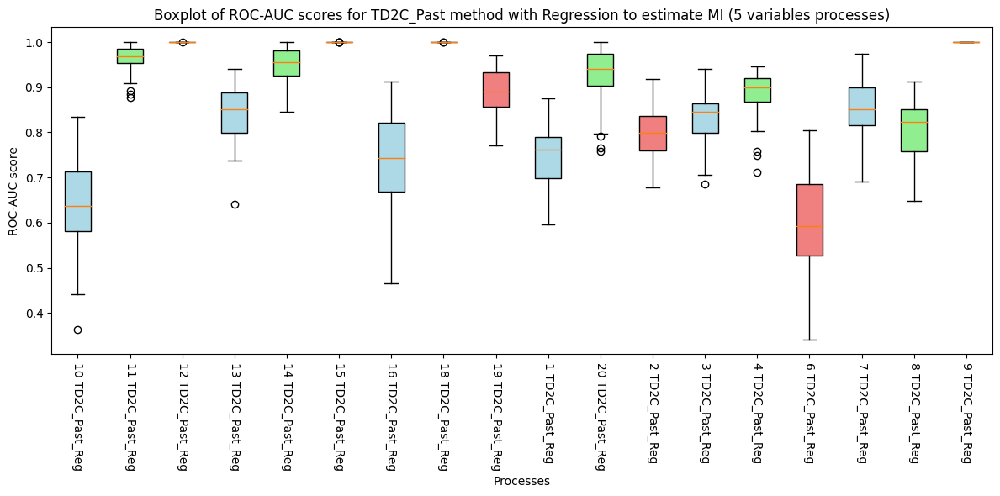

In [6]:
#################################################################### LOAD DATA #####################################################################
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/journals/'

with open(os.path.join(input_folder, 'journal_results_td2c_past_R_N5.pkl'), 'rb') as f:
    TD2C_Ranking_PastFut_rocs_process, TD2C_Ranking_PastFut_precision_process, TD2C_Ranking_PastFut_recall_process, TD2C_Ranking_PastFut_f1_process = pickle.load(f) 

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)


##################################################################### PLOT #########################################################################

df1 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} TD2C_Past_Reg')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Boxplot of ROC-AUC scores for TD2C_Past method with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

## KNNCMI Estimation of MI

### D2C (& D2C but without contemporaneous nodes) 

#### Descriptors Generation

In [4]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/D2C/'  

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='cmiknn_3',
            mb_estimator= 'original',
            top_vars=3)

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

  0%|          | 0/18 [00:00<?, ?it/s]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

  6%|▌         | 1/18 [00:49<13:57, 49.24s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 11%|█         | 2/18 [01:36<12:53, 48.32s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y

 17%|█▋        | 3/18 [02:49<14:48, 59.24s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y:

 22%|██▏       | 4/18 [03:50<13:58, 59.91s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 28%|██▊       | 5/18 [04:34<11:45, 54.27s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 33%|███▎      | 6/18 [05:17<10:07, 50.59s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y:

 39%|███▉      | 7/18 [06:00<08:48, 48.00s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 44%|████▍     | 8/18 [06:48<08:01, 48.14s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 50%|█████     | 9/18 [07:51<07:55, 52.79s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 56%|█████▌    | 10/18 [08:54<07:26, 55.75s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 61%|██████    | 11/18 [09:38<06:04, 52.08s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y:

 67%|██████▋   | 12/18 [10:39<05:29, 54.86s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 72%|███████▏  | 13/18 [11:43<04:48, 57.70s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 78%|███████▊  | 14/18 [12:47<03:58, 59.56s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 83%|████████▎ | 15/18 [13:50<03:01, 60.51s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)


Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 89%|████████▉ | 16/18 [14:51<02:01, 60.64s/it]

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

 94%|█████████▍| 17/18 [15:52<01:01, 61.01s/it]

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)Shape of X: (245, 29), Shape of Y: (245,)

Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y: (245,)
Shape of X: (245, 29), Shape of Y:

100%|██████████| 18/18 [16:52<00:00, 56.24s/it]


#### Run Classifier

In [5]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []
descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/D2C/'

# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [6]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file

for n_vars, todo in todos.items():
    d2c_rocs_process = {}
    d2c_precision_process = {}
    d2c_recall_process = {}
    d2c_f1_process = {}
    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        d2c_rocs_process[gen_process_number] = rocs
        d2c_precision_process[gen_process_number] = precisions
        d2c_recall_process[gen_process_number] = recalls
        d2c_f1_process[gen_process_number] = f1s

  0%|          | 0/18 [00:00<?, ?it/s]

 78%|███████▊  | 14/18 [01:37<00:27,  6.83s/it]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarin

#### Save Results

In [7]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_d2c_R_N5.pkl'), 'wb') as f:
    everything = (d2c_rocs_process, d2c_precision_process, d2c_recall_process, d2c_f1_process)
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N10.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N25.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Plot

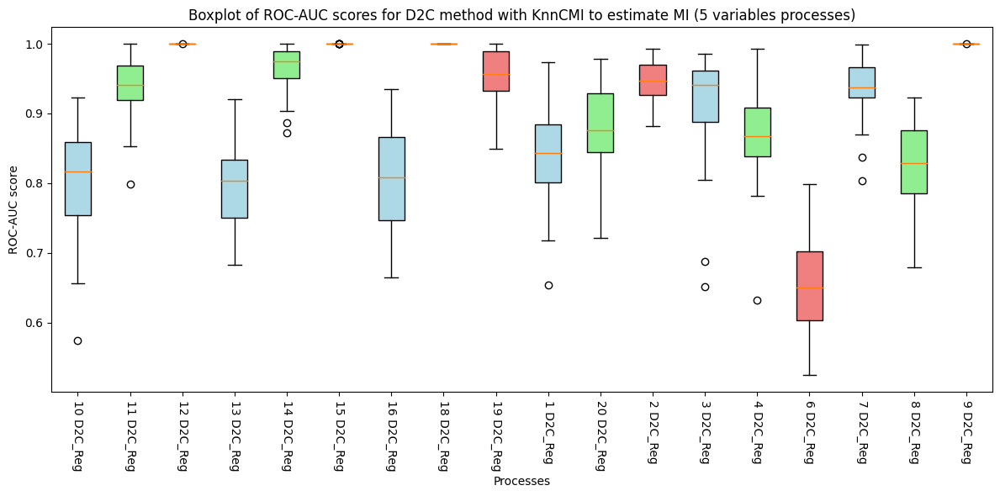

In [8]:
#################################################################### LOAD DATA #####################################################################
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

with open(os.path.join(input_folder, 'journal_results_d2c_R_N5.pkl'), 'rb') as f:
    D2C_rocs_process, D2C_precision_process, D2C_recall_process, D2C_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)


##################################################################### PLOT #########################################################################

df1 = pd.DataFrame(D2C_rocs_process)

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} D2C_Reg')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Boxplot of ROC-AUC scores for D2C method with KnnCMI to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

### TD2C (& TD2C but without contrmporaneous nodes)

#### Descriptors Generation

In [4]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C/'  

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='cmiknn_3',
            mb_estimator= 'ts',
            top_vars=3)

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

  0%|          | 0/18 [00:00<?, ?it/s]

100%|██████████| 18/18 [20:49<00:00, 69.41s/it]


#### Run Classifier

In [5]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []
descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C/'

# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [6]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file

for n_vars, todo in todos.items():
    td2c_rocs_process = {}
    td2c_precision_process = {}
    td2c_recall_process = {}
    td2c_f1_process = {}
    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        td2c_rocs_process[gen_process_number] = rocs
        td2c_precision_process[gen_process_number] = precisions
        td2c_recall_process[gen_process_number] = recalls
        td2c_f1_process[gen_process_number] = f1s

 67%|██████▋   | 12/18 [01:27<00:41,  7.00s/it]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
100%|██████████| 18/18 [02:09<00:00,  7.18s/it]


#### Save Results

In [7]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_td2c_R_N5.pkl'), 'wb') as f:
    everything = (td2c_rocs_process, td2c_precision_process, td2c_recall_process, td2c_f1_process)
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_td2c_R_N10.pkl'), 'wb') as f:
#     everything = (td2c_R_rocs_process, td2c_R_precision_process, td2c_R_recall_process, td2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_td2c_R_N25.pkl'), 'wb') as f:
#     everything = (td2c_R_rocs_process, td2c_R_precision_process, td2c_R_recall_process, td2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Plot

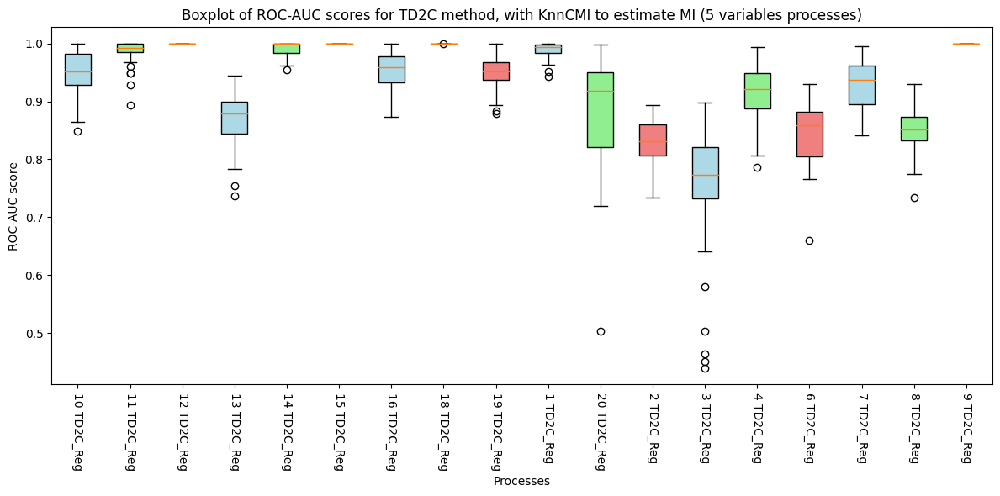

In [8]:
#################################################################### LOAD DATA #####################################################################
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

with open(os.path.join(input_folder, 'journal_results_td2c_R_N5.pkl'), 'rb') as f:
    TD2C_rocs_process, TD2C_precision_process, TD2C_recall_process, TD2C_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)


##################################################################### PLOT #########################################################################

df1 = pd.DataFrame(TD2C_rocs_process)

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} TD2C_Reg')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Boxplot of ROC-AUC scores for TD2C method, with KnnCMI to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

### TD2C + Ranking (All methods)

#### Descriptors Generation

In [ ]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################

# SET FOLDER
cartella = 8
# 1 = TD2C_+Ranking_1
# 2 = TD2C_+Ranking_2
# 3 = TD2C_+Ranking_3, 
# 4 = TD2C_+Ranking_NoCont
# 11 = TD2C_+Ranking_1 with two variables from ranking 
# 111 = TD2C_+Ranking_1 with three variables from ranking
# 110 = TD2C_+Ranking_1 with ten variables from ranking
# 5 = TD2C_+Ranking_4 with one variable from ranking
# 6 = TD2C_+Ranking_5 with one variable from ranking
# 7 = TD2C_+Ranking_6 with one variable from ranking
# 8 = TD2C_+Ranking_7 with one variable from ranking

if cartella == 1:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/1_Var/' 
    ts_rank = 'ts_rank'
    vars_to_keep = 1
elif cartella == 11:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/2_Var/'
    ts_rank = 'ts_rank'
    vars_to_keep = 2
elif cartella == 111:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/3_Var/'
    ts_rank = 'ts_rank'
    vars_to_keep = 3
elif cartella == 110:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/10_Var/'
    ts_rank = 'ts_rank'
    vars_to_keep = 10
elif cartella == 2:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_2/'
    ts_rank = 'ts_rank_2'
    vars_to_keep = 1
elif cartella == 3:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_3/'
    ts_rank = 'ts_rank_3'
    vars_to_keep = 1
elif cartella == 4:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_NoCont/'
    ts_rank = 'ts_rank_no_cont' 
    vars_to_keep = 1
elif cartella == 5:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_4/'
    ts_rank = 'ts_rank_4' 
    vars_to_keep = 1
elif cartella == 6:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_5/'
    ts_rank = 'ts_rank_5' 
    vars_to_keep = 1
elif cartella == 7:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_6/'
    ts_rank = 'ts_rank_6' 
    vars_to_keep = 1
elif cartella == 8:
    output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_7/'
    ts_rank = 'ts_rank_7' 
    vars_to_keep = 1

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='cmiknn_3',
            mb_estimator= ts_rank,
            top_vars = vars_to_keep)

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

  0%|          | 0/18 [00:00<?, ?it/s]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

  6%|▌         | 1/18 [00:27<07:43, 27.24s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y:

 11%|█         | 2/18 [00:52<06:57, 26.07s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)




Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y:

 17%|█▋        | 3/18 [01:25<07:15, 29.01s/it]

Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 22%|██▏       | 4/18 [01:57<07:07, 30.53s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y:

 28%|██▊       | 5/18 [02:24<06:20, 29.31s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)


Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 33%|███▎      | 6/18 [02:48<05:29, 27.46s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 39%|███▉      | 7/18 [03:12<04:48, 26.24s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 44%|████▍     | 8/18 [03:36<04:15, 25.55s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 50%|█████     | 9/18 [04:02<03:50, 25.64s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 56%|█████▌    | 10/18 [04:37<03:47, 28.50s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)


Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 61%|██████    | 11/18 [05:01<03:10, 27.27s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 67%|██████▋   | 12/18 [05:40<03:03, 30.62s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)



Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 72%|███████▏  | 13/18 [06:12<02:35, 31.09s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 78%|███████▊  | 14/18 [06:44<02:05, 31.36s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y:

 83%|████████▎ | 15/18 [07:19<01:37, 32.58s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)



Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)


Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)



Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y:

 89%|████████▉ | 16/18 [07:51<01:04, 32.29s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

 94%|█████████▍| 17/18 [08:23<00:32, 32.28s/it]

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)Shape of X: (245, 27), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)
Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y: (245,)Shape of X: (245, 28), Shape of Y: (245,)

Shape of X: (245, 27), Shape of Y: (245,)
Shape of X: (245, 28), Shape of Y:

100%|██████████| 18/18 [08:56<00:00, 29.83s/it]


#### Run Classifier

In [ ]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []

# TAKES THE FOLDER SET AT THE STEP BEFORE AND RUN ALL THE FOLLOWING CELLS FOR THIS METHOD
# 1 = TD2C_+Ranking_1
# 2 = TD2C_+Ranking_2
# 3 = TD2C_+Ranking_3
# 4 = TD2C_+Ranking_NoCont
# 11 = TD2C_+Ranking_1 with two variables from ranking 
# 111 = TD2C_+Ranking_1 with three variables from ranking
# 110 = TD2C_+Ranking_1 with ten variables from ranking
# 5 = TD2C_+Ranking_4 with two variables from ranking
# 6 = TD2C_+Ranking_5 with three variables from ranking

if cartella == 1:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/1_Var/' 
    name = 'TD2C_Ranking_1_1_Var'
elif cartella == 11:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/2_Var/'
    name = 'TD2C_Ranking_1_2_Var'
elif cartella == 111:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/3_Var/'
    name = 'TD2C_Ranking_1_3_Var'
elif cartella == 110:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_1/10_Var/'
    name = 'TD2C_Ranking_1_10_Var'
elif cartella == 2:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_2/'
    name = 'TD2C_Ranking_2'
elif cartella == 3:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C_+Ranking_3/'
    name = 'TD2C_Ranking_3'
elif cartella == 4:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_NoCont/'
    name = 'TD2C_Ranking_NoCont'
elif cartella == 5:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_4/'
    name = 'TD2C_Ranking_4'
elif cartella == 6:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_5/'
    name = 'TD2C_Ranking_5'
elif cartella == 7:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_6/'
    name = 'TD2C_Ranking_6'
elif cartella == 8:
    descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_+Ranking/TD2C+Ranking_7/'
    name = 'TD2C_Ranking_7'



# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [ ]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file


for n_vars, todo in todos.items():
    m1 = f'{name}_rocs_process'
    m2 = f'{name}_precision_process'
    m3 = f'{name}_recall_process'
    m4 = f'{name}_f1_process'

    globals()[m1] = {}
    globals()[m2] = {}
    globals()[m3] = {}
    globals()[m4] = {}


    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        globals()[m1][gen_process_number] = rocs
        globals()[m2][gen_process_number] = precisions
        globals()[m3][gen_process_number] = recalls
        globals()[m4][gen_process_number] = f1s

  0%|          | 0/18 [00:00<?, ?it/s]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/my

#### Save Results

In [ ]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_{name}_N5.pkl'), 'wb') as f:
    everything = (globals()[m1], globals()[m2], globals()[m3], globals()[m4])
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N10.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N25.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Load data for local and global plots

##### local save

In [ ]:
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

# LOCAL
with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
    globals()[m1], globals()[m2], globals()[m3], globals()[m4] = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

##### global save

In [ ]:
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

cartella = 8

if cartella == 1:
    name = 'TD2C_Ranking_1_1_Var'
elif cartella == 11:
    name = 'TD2C_Ranking_1_2_Var'
elif cartella == 111:
    name = 'TD2C_Ranking_1_3_Var'
elif cartella == 110:
    name = 'TD2C_Ranking_1_10_Var'
elif cartella == 2:
    name = 'TD2C_Ranking_2'
elif cartella == 3:
    name = 'TD2C_Ranking_3'
elif cartella == 4:
    name = 'TD2C_Ranking_NoCont'
elif cartella == 5:
    name = 'TD2C_Ranking_4'
elif cartella == 6:
    name = 'TD2C_Ranking_5'
elif cartella == 7:
    name = 'TD2C_Ranking_6'
elif cartella == 8:
    name = 'TD2C_Ranking_7'

if cartella == 1:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_1_Var_rocs_process, TD2C_Ranking_1_1_Var_precision_process, TD2C_Ranking_1_1_Var_recall_process, TD2C_Ranking_1_1_Var_f1_process = pickle.load(f)
elif cartella == 11:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_2_Var_rocs_process, TD2C_Ranking_1_2_Var_precision_process, TD2C_Ranking_1_2_Var_recall_process, TD2C_Ranking_1_2_Var_f1_process = pickle.load(f)
elif cartella == 111:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_3_Var_rocs_process, TD2C_Ranking_1_3_Var_precision_process, TD2C_Ranking_1_3_Var_recall_process, TD2C_Ranking_1_3_Var_f1_process = pickle.load(f)
elif cartella == 110:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_1_10_Var_rocs_process, TD2C_Ranking_1_10_Var_precision_process, TD2C_Ranking_1_10_Var_recall_process, TD2C_Ranking_1_10_Var_f1_process = pickle.load(f)
elif cartella == 2:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_2_rocs_process, TD2C_Ranking_2_precision_process, TD2C_Ranking_2_recall_process, TD2C_Ranking_2_f1_process = pickle.load(f)
elif cartella == 3:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_3_rocs_process, TD2C_Ranking_3_precision_process, TD2C_Ranking_3_recall_process, TD2C_Ranking_3_f1_process = pickle.load(f)
elif cartella == 4:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_NoCont_rocs_process, TD2C_Ranking_NoCont_precision_process, TD2C_Ranking_NoCont_recall_process, TD2C_Ranking_NoCont_f1_process = pickle.load(f)
elif cartella == 5:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_4_rocs_process, TD2C_Ranking_4_precision_process, TD2C_Ranking_4_recall_process, TD2C_Ranking_4_f1_process = pickle.load(f)
elif cartella == 6:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_5_rocs_process, TD2C_Ranking_5_precision_process, TD2C_Ranking_5_recall_process, TD2C_Ranking_5_f1_process = pickle.load(f)
elif cartella == 7:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_6_rocs_process, TD2C_Ranking_6_precision_process, TD2C_Ranking_6_recall_process, TD2C_Ranking_6_f1_process = pickle.load(f)
elif cartella == 8:
    with open(os.path.join(input_folder, f'journal_results_{name}_N5.pkl'), 'rb') as f:
        TD2C_Ranking_7_rocs_process, TD2C_Ranking_7_precision_process, TD2C_Ranking_7_recall_process, TD2C_Ranking_7_f1_process = pickle.load(f)

#### Plot

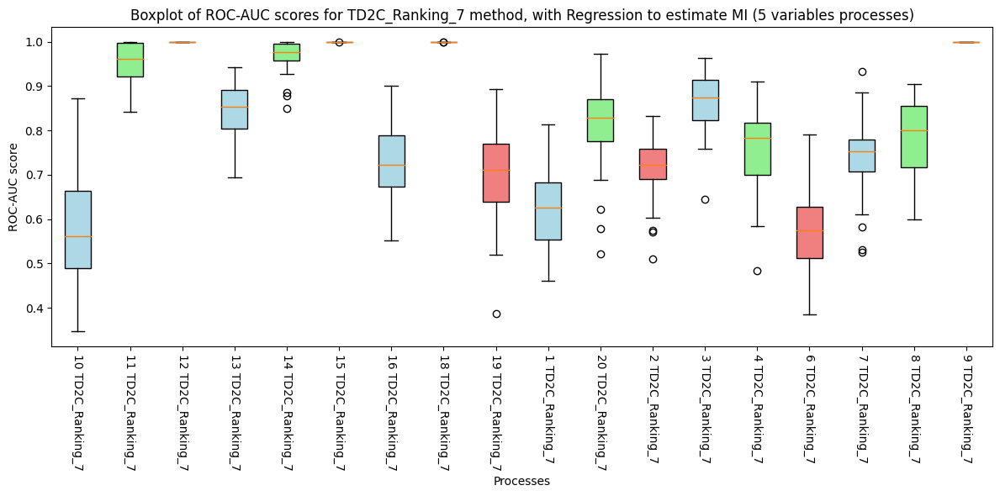

In [ ]:
df1 = pd.DataFrame(globals()[m1])
df_name = f'{name}_rocs_dataset'
globals()[df_name] = df1

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} {name}')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title(f'Boxplot of ROC-AUC scores for {name} method, with KnnCMI to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

### TD2C in the past-future (& TD2C in the past-future but without contrmporaneous nodes)

#### Descriptors Generation

In [ ]:
######################################################### SETTING FOR DESCRIPTORS COMPUTATION ######################################################

input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_process = [] # list of files to process

# This loop is used to filter the files to process and obtain the parameters of the process
# The resulting list will be used to parallelize the process and will be passed to the DataLoader.
# The result is of the form (file, gen_process_number, n_variables, max_neighborhood_size, noise_std)
# asnd is saved in the to_process list.
for file in sorted(os.listdir(input_folder)): 
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

    if noise_std != 0.01:
        continue
    
    if max_neighborhood_size != 2:
        continue

    # if n_variables != 5:
    #     continue

    to_process.append(file)


############################################################### COMPUTE DESCRIPTORS ################################################################
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_PastFut/'  

# create output folder if it does not exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# This loop processes the files in the input folder (to_process) and saves the descriptors in the output folder.

# At first, we collect the parameters of the process from the file name.
for file in tqdm(to_process):
    gen_process_number = int(file.split('_')[0][1:])
    n_variables = int(file.split('_')[1][1:])
    max_neighborhood_size = int(file.split('_')[2][2:])
    noise_std = float(file.split('_')[3][1:-4])

# The DataLoader is initialized with the parameters of the process. 
    dataloader = DataLoader(n_variables = n_variables,
                    maxlags = maxlags)
    dataloader.from_pickle(input_folder+file)

# The D2C object is initialized with the DataLoader and the parameters of the process.
    d2c = D2C(observations=dataloader.get_observations(), 
            dags=dataloader.get_dags(), 
            couples_to_consider_per_dag=COUPLES_TO_CONSIDER_PER_DAG, 
            MB_size=MB_SIZE, 
            n_variables=n_variables, 
            maxlags=maxlags,
            seed=SEED,
            n_jobs=N_JOBS,
            full=True,
            quantiles=True,
            normalize=True,
            cmi='cmiknn_3',
            mb_estimator= 'ts_past')

    d2c.initialize() # initializes the D2C object

    descriptors_df = d2c.get_descriptors_df()  # computes the descriptors

    descriptors_df.insert(0, 'process_id', gen_process_number)
    descriptors_df.insert(2, 'n_variables', n_variables)
    descriptors_df.insert(3, 'max_neighborhood_size', max_neighborhood_size)
    descriptors_df.insert(4, 'noise_std', noise_std)

    # The descriptors are saved in the output folder as a pickle file.
    descriptors_df.to_pickle(output_folder+f'P{gen_process_number}_N{n_variables}_Nj{max_neighborhood_size}_n{noise_std}_MB{MB_SIZE}.pkl')

100%|██████████| 18/18 [04:44<00:00, 15.79s/it]


#### Run Classifier

In [ ]:
data_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/data/to_use/'

to_dos = []

# This loop gets a list of all the files to be processed
for testing_file in sorted(os.listdir(data_root)):
    if testing_file.endswith('.pkl'):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])
          
        if noise_std != 0.01: # if the noise is different we skip the file
            continue

        if max_neighborhood_size != 2: # if the max_neighborhood_size is different we skip the file
            continue

        to_dos.append(testing_file) # we add the file to the list (to_dos) to be processed

# sort to_dos by number of variables
to_dos_5_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 5]
# to_dos_10_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 10]
# to_dos_25_variables = [file for file in to_dos if int(file.split('_')[1][1:]) == 25]

# we create a dictionary with the lists of files to be processed
todos = {'5': to_dos_5_variables} # , '10': to_dos_10_variables, '25': to_dos_25_variables

# we create a dictionary to store the results
dfs = []
descriptors_root = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/descriptors/KnnCMI/TD2C_PastFut/'

# Re-save pickle files with protocol 4
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        file_path = os.path.join(descriptors_root, testing_file)
        with open(file_path, 'rb') as f:
            data = pickle.load(f)
        
        # Re-save with protocol 4
        with open(file_path, 'wb') as f:
            pickle.dump(data, f, protocol=4)

# This loop gets the descriptors for the files to be processed
for testing_file in sorted(os.listdir(descriptors_root)):
    if testing_file.endswith('.pkl'):
        df = pd.read_pickle(os.path.join(descriptors_root, testing_file))
        if isinstance(df, pd.DataFrame):
            dfs.append(df)

# we concatenate the descriptors
descriptors_training = pd.concat(dfs, axis=0).reset_index(drop=True)

#### Evaluation Metrics

In [ ]:
# This loop does the following:
# 1. Creates some dictionaries to store the results
# 2. Loads the training data
# 3. Trains the model
# 4. Evaluates the model
# 5. Stores the results in the dictionaries
# 6. Saves the dictionaries in a pickle file

for n_vars, todo in todos.items():
    td2c_past_rocs_process = {}
    td2c_past_precision_process = {}
    td2c_past_recall_process = {}
    td2c_past_f1_process = {}
    for testing_file in tqdm(todo):
        gen_process_number = int(testing_file.split('_')[0][1:])
        n_variables = int(testing_file.split('_')[1][1:])
        max_neighborhood_size = int(testing_file.split('_')[2][2:])
        noise_std = float(testing_file.split('_')[3][1:-4])

        # split training and testing data
        training_data = descriptors_training.loc[descriptors_training['process_id'] != gen_process_number]
        X_train = training_data.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
        y_train = training_data['is_causal']

        testing_data = descriptors_training.loc[(descriptors_training['process_id'] == gen_process_number) & (descriptors_training['n_variables'] == n_variables) & (descriptors_training['max_neighborhood_size'] == max_neighborhood_size) & (descriptors_training['noise_std'] == noise_std)]

        model = BalancedRandomForestClassifier(n_estimators=100, random_state=0, n_jobs=50, max_depth=None, sampling_strategy='auto', replacement=True, bootstrap=False)
        # model = RandomForestClassifier(n_estimators=50, random_state=0, n_jobs=50, max_depth=10)

        model.fit(X_train, y_train)

        rocs = {}
        precisions = {}
        recalls = {}
        f1s = {}
        for graph_id in range(40):
            #load testing descriptors
            test_df = testing_data.loc[testing_data['graph_id'] == graph_id]
            test_df = test_df.sort_values(by=['edge_source','edge_dest']).reset_index(drop=True) # sort for coherence

            X_test = test_df.drop(columns=['process_id', 'graph_id', 'n_variables', 'max_neighborhood_size','noise_std', 'edge_source', 'edge_dest', 'is_causal',])
            y_test = test_df['is_causal']

            y_pred_proba = model.predict_proba(X_test)[:,1]
            y_pred = model.predict(X_test)

            roc = roc_auc_score(y_test, y_pred_proba)
            precision = precision_score(y_test, y_pred)
            recall = recall_score(y_test, y_pred)
            f1 = f1_score(y_test, y_pred)
            
            rocs[graph_id] = roc
            precisions[graph_id] = precision
            recalls[graph_id] = recall
            f1s[graph_id] = f1

        td2c_past_rocs_process[gen_process_number] = rocs
        td2c_past_precision_process[gen_process_number] = precisions
        td2c_past_recall_process[gen_process_number] = recalls
        td2c_past_f1_process[gen_process_number] = f1s

  0%|          | 0/18 [00:00<?, ?it/s]/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/myenv3.8/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/jpalombarini/td2c/my

#### Save Results

In [ ]:
# pickle everything
output_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

# Create the folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

with open(os.path.join(output_folder, f'journal_results_td2c_past_R_N5.pkl'), 'wb') as f:
    everything = (td2c_past_rocs_process, td2c_past_precision_process, td2c_past_recall_process, td2c_past_f1_process)
    pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N10.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)

# with open(os.path.join(output_folder, f'journal_results_d2c_R_N25.pkl'), 'wb') as f:
#     everything = (d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process)
#     pickle.dump(everything, f)  

#### Plot

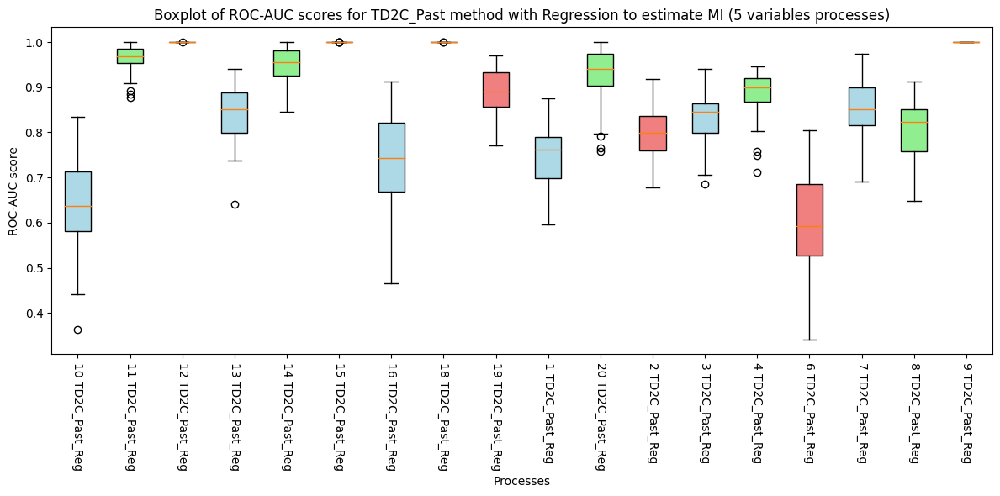

In [ ]:
#################################################################### LOAD DATA #####################################################################
input_folder = '/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/KnnCMI/journals/'

with open(os.path.join(input_folder, 'journal_results_td2c_past_R_N5.pkl'), 'rb') as f:
    TD2C_Ranking_PastFut_rocs_process, TD2C_Ranking_PastFut_precision_process, TD2C_Ranking_PastFut_recall_process, TD2C_Ranking_PastFut_f1_process = pickle.load(f) 

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N10.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)

# with open(os.path.join(input_folder, 'journal_results_d2c_R_N25.pkl'), 'rb') as f:
#     d2c_R_rocs_process, d2c_R_precision_process, d2c_R_recall_process, d2c_R_f1_process = pickle.load(f)


##################################################################### PLOT #########################################################################

df1 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)

# Combine data for boxplot
combined_data = []

for col in df1.columns:
    combined_data.append(df1[col])

# Create labels for x-axis
labels = []
for col in df1.columns:
    labels.append(f'{col} TD2C_Past_Reg')

# Plotting
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])


plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Boxplot of ROC-AUC scores for TD2C_Past method with KnnCMI to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('ROC-AUC score')
plt.tight_layout()
plt.show()

# Plot all Results - Comparison

## Regression for MI estimation

### ROC-AUC

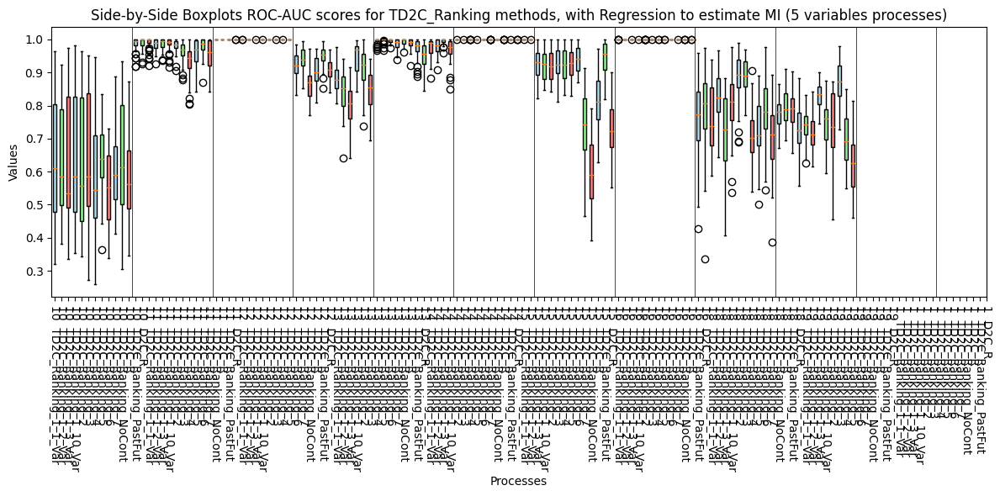

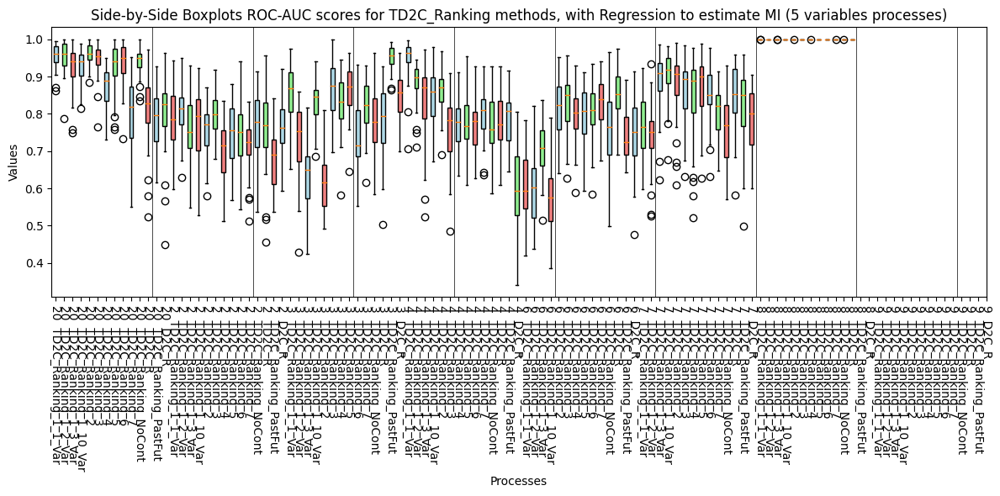

In [144]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_rocs_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

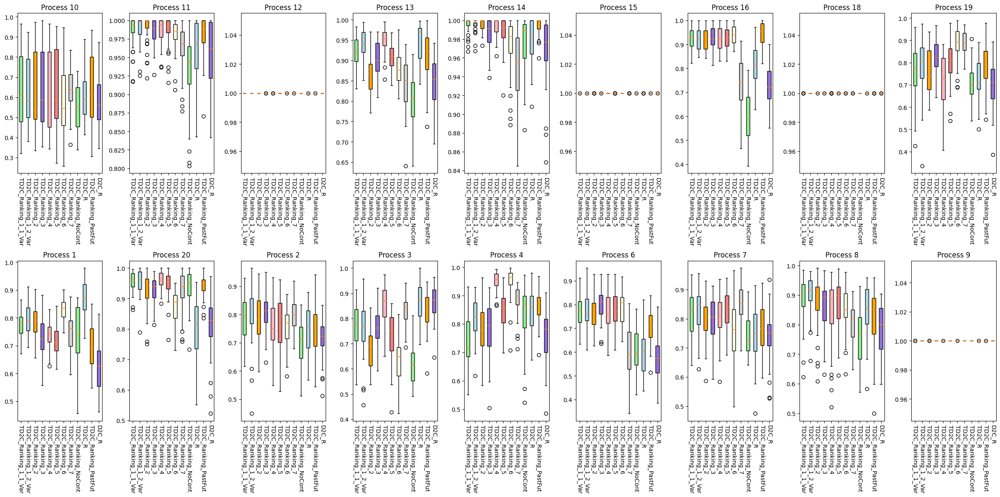

In [145]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_rocs_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocouc_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



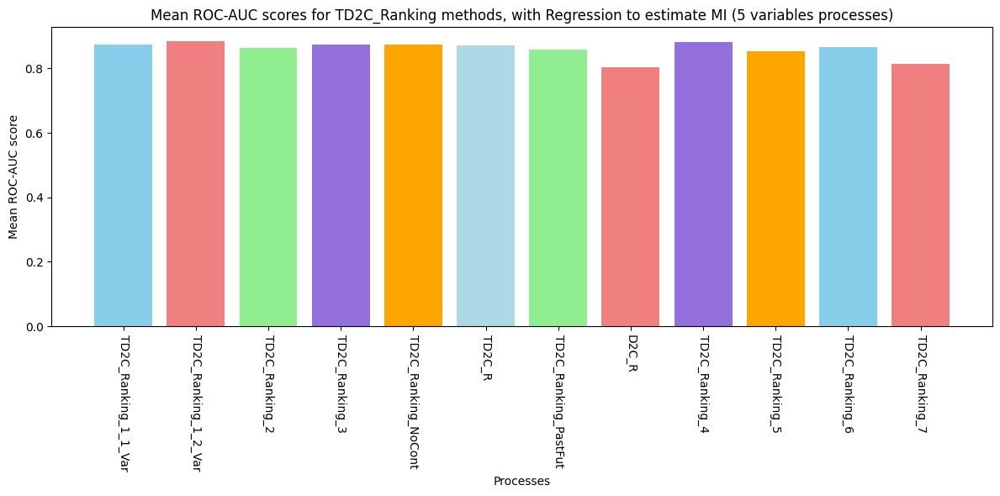

In [146]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean ROC-AUC score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [147]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_rocs_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='roc_auc')

df['roc_auc'] = df['roc_auc'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='roc_auc')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_rocs_process': 'TD2C_+Ranking_1_1_Var_rocs_process', 
                        'TD2C_+Ranking_1_2_Var_rocs_process': 'TD2C_+Ranking_1_2_Var_rocs_process', 
                        # 'TD2C_+Ranking_1_3_Var_rocs_process': 'TD2C_+Ranking_1_3_Var_rocs_process',
                        # 'TD2C_+Ranking_1_10_Var_rocs_process': 'TD2C_+Ranking_1_10_Var_rocs_process', 
                        'TD2C_+Ranking_2_rocs_process': 'TD2C_+Ranking_2_rocs_process', 
                        'TD2C_+Ranking_3_rocs_process': 'TD2C_+Ranking_3_rocs_process',
                        'TD2C_+Ranking_4_rocs_process': 'TD2C_+Ranking_4_rocs_process', 
                        'TD2C_+Ranking_NoCont_rocs_process': 'TD2C_+Ranking_NoCont_rocs_process',
                        'TD2C_R_rocs_process': 'TD2C_R_rocs_process',
                        'TD2C_+Ranking_PastFut_rocs_process': 'TD2C_+Ranking_PastFut_rocs_process',
                        'D2C_R_rocs_process': 'D2C_R_rocs_process'})

# eliminate the column method and make the process_id the index of the dataframe



# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/1535410291.py:56: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.739713,0.831485,0.776474,0.792724,0.786540,0.728764,0.738762,0.872446,0.695454,0.625059,0.721796,0.744201
1,2,0.699584,0.762302,0.785803,0.801894,0.787708,0.804403,0.751823,0.748472,0.744452,0.714935,0.770985,0.796404
2,3,0.619943,0.640468,0.767228,0.762528,0.680382,0.763604,0.855596,0.862550,0.824647,0.865537,0.730545,0.833735
3,4,0.824904,0.948410,0.737984,0.823518,0.782313,0.788145,0.950989,0.847511,0.860338,0.764641,0.849227,0.883992
4,6,0.606133,0.788516,0.768994,0.772028,0.768492,0.802143,0.766983,0.605880,0.706710,0.576266,0.775122,0.603968
5,7,0.743818,0.755143,0.821000,0.829179,0.798978,0.791879,0.798718,0.743801,0.761630,0.738880,0.831707,0.853853
6,8,0.753271,0.850260,0.882939,0.904632,0.873245,0.862437,0.842162,0.849258,0.820393,0.788382,0.870937,0.802810
7,9,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,10,0.546480,0.592764,0.632131,0.629828,0.615599,0.625865,0.615933,0.598305,0.636053,0.580792,0.632631,0.641167
9,11,0.932885,0.981141,0.985230,0.988471,0.989112,0.985222,0.985297,0.959235,0.979821,0.951416,0.985314,0.962049


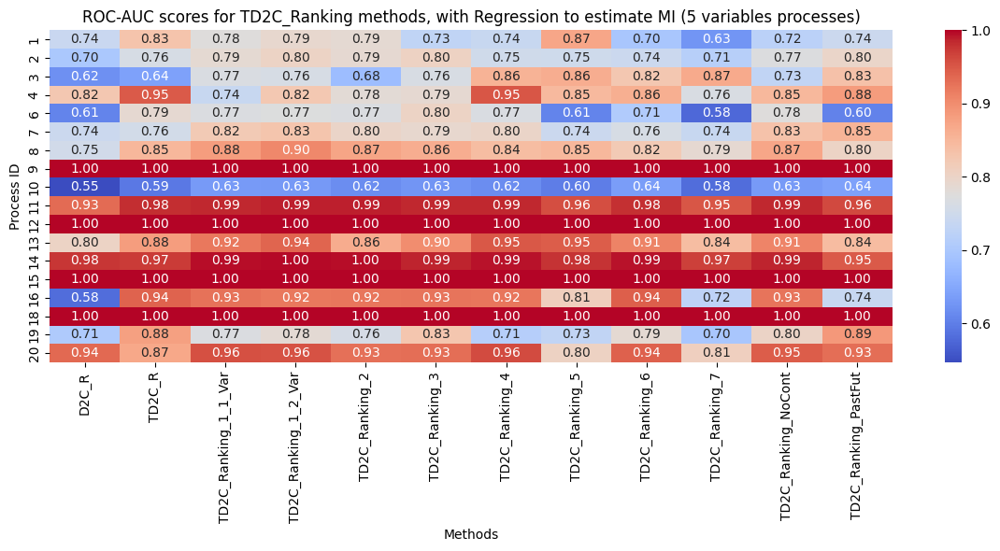

In [148]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_heatmap_TD2C_Ranking.pdf')

plt.show()

In [149]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'roc_auc'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,roc_auc
0,1,0.754452
1,2,0.764064
2,3,0.767230
3,4,0.838498
4,6,0.711770
5,7,0.789049
6,8,0.841727
7,9,1.000000
8,10,0.612296
9,11,0.973766


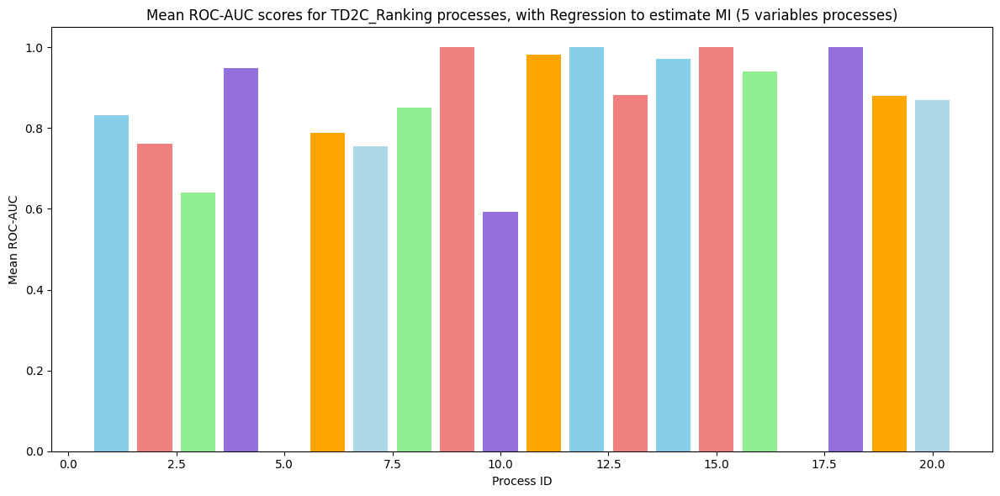

In [150]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean ROC-AUC scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean ROC-AUC')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [151]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'roc_auc'})

df = df.sort_values(by='roc_auc', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/rocauc_td2c_ranking_avg.csv', index=False)

df

,method,roc_auc
1,TD2C_Ranking_1_2_Var,0.883526
2,TD2C_Ranking_4,0.880354
3,TD2C_Ranking_NoCont,0.874187
4,TD2C_Ranking_1_1_Var,0.873577
5,TD2C_Ranking_3,0.873380
6,TD2C_R,0.871846
7,TD2C_Ranking_6,0.867173
8,TD2C_Ranking_2,0.864079
9,TD2C_Ranking_PastFut,0.859403
10,TD2C_Ranking_5,0.853142


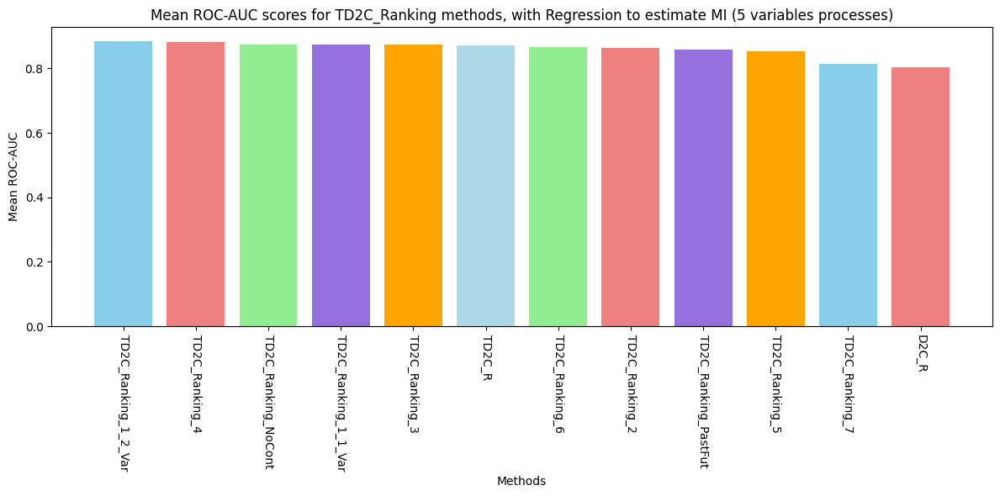

In [152]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['roc_auc'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean ROC-AUC')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_barplot_TD2C_Ranking_avg.pdf')

plt.show()

### Precision

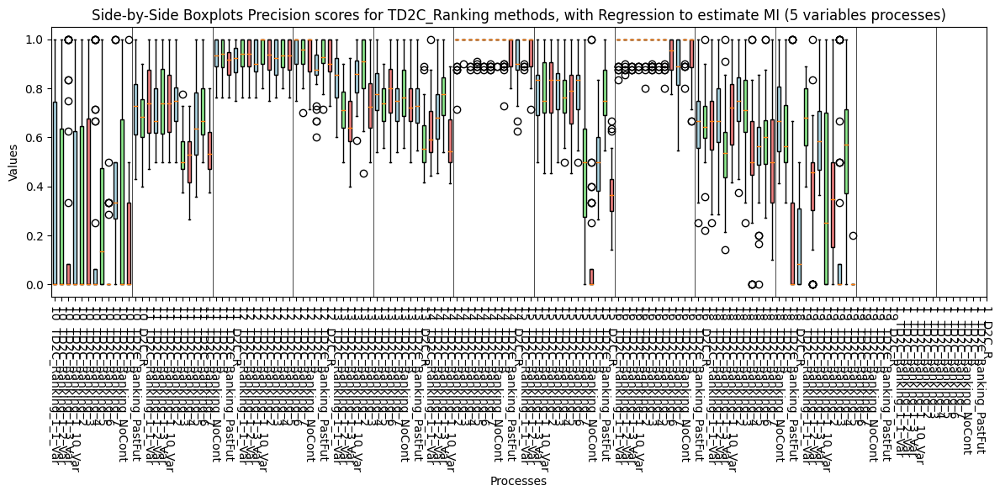

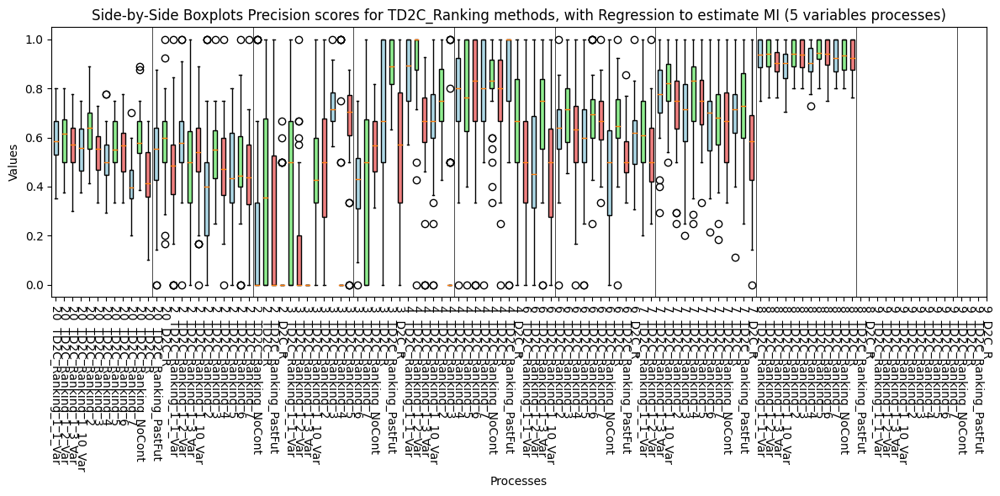

In [153]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_precision_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)

# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

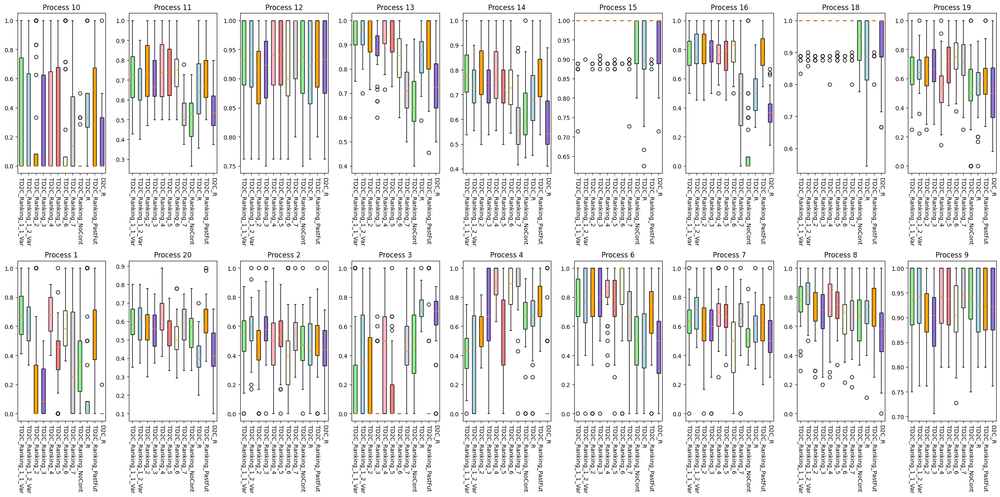

In [154]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_precision_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)

# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



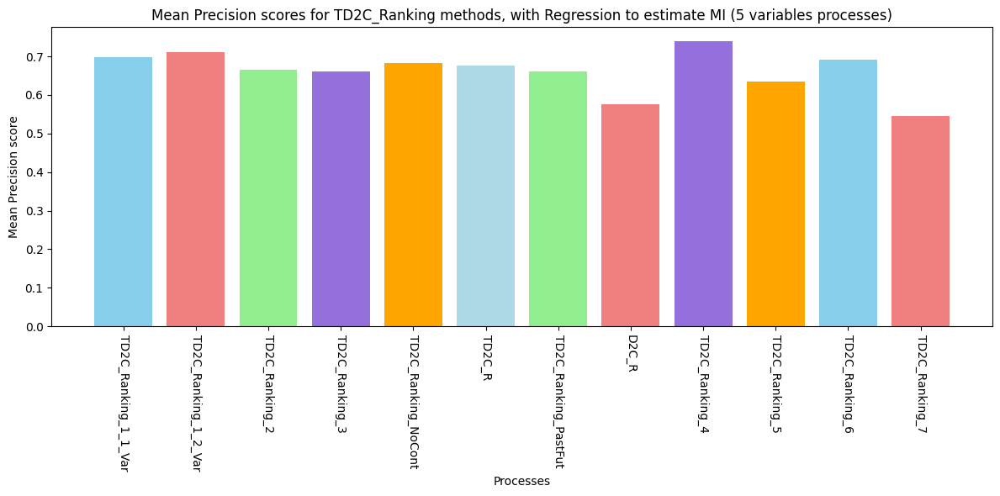

In [155]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)


# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean Precision score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [156]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_precision_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='Precision')

df['Precision'] = df['Precision'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='Precision')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_precision_process': 'TD2C_+Ranking_1_1_Var_precision_process',
                        'TD2C_+Ranking_1_2_Var_precision_process': 'TD2C_+Ranking_1_2_Var_precision_process',
                        # 'TD2C_+Ranking_1_3_Var_precision_process': 'TD2C_+Ranking_1_3_Var_precision_process',
                        # 'TD2C_+Ranking_1_10_Var_precision_process': 'TD2C_+Ranking_1_10_Var_precision_process',
                        'TD2C_+Ranking_2_precision_process': 'TD2C_+Ranking_2_precision_process',
                        'TD2C_+Ranking_3_precision_process': 'TD2C_+Ranking_3_precision_process',
                        'TD2C_+Ranking_4_precision_process': 'TD2C_+Ranking_4_precision_process',
                        'TD2C_+Ranking_NoCont_precision_process': 'TD2C_+Ranking_NoCont_precision_process',
                        'TD2C_R_precision_process': 'TD2C_R_precision_process',
                        'TD2C_+Ranking_PastFut_precision_process': 'TD2C_+Ranking_PastFut_precision_process',
                        'D2C_R_precision_process': 'D2C_R_precision_process'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/29425775.py:56: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.351590,0.611294,0.691583,0.621413,0.181875,0.163841,0.677615,0.187500,0.555780,0.005000,0.393927,0.368810
1,2,0.472477,0.380730,0.517569,0.571711,0.453700,0.580793,0.472339,0.458175,0.484106,0.427567,0.518416,0.540990
2,3,0.479871,0.000000,0.231667,0.389018,0.241944,0.081667,0.464692,0.740705,0.143750,0.640505,0.133036,0.429375
3,4,0.627431,0.858614,0.420298,0.433449,0.575201,0.642083,0.881555,0.643166,0.770882,0.157500,0.547108,0.908234
4,6,0.490506,0.826607,0.754117,0.770027,0.765744,0.798065,0.816089,0.468056,0.681776,0.444196,0.763935,0.624812
5,7,0.532769,0.472624,0.628207,0.701290,0.591916,0.577363,0.691435,0.596447,0.625680,0.539732,0.663636,0.659743
6,8,0.637415,0.660033,0.763742,0.809555,0.721327,0.683438,0.767585,0.692821,0.711215,0.557925,0.740998,0.662747
7,9,0.932632,0.908214,0.924977,0.931677,0.911094,0.899412,0.933251,0.920170,0.927913,0.916717,0.928405,0.949482
8,10,0.044643,0.200298,0.299827,0.260982,0.209375,0.230060,0.301771,0.370261,0.321190,0.151811,0.287649,0.276061
9,11,0.505737,0.738926,0.720292,0.683246,0.744955,0.707604,0.743648,0.658339,0.696081,0.542591,0.751146,0.531013


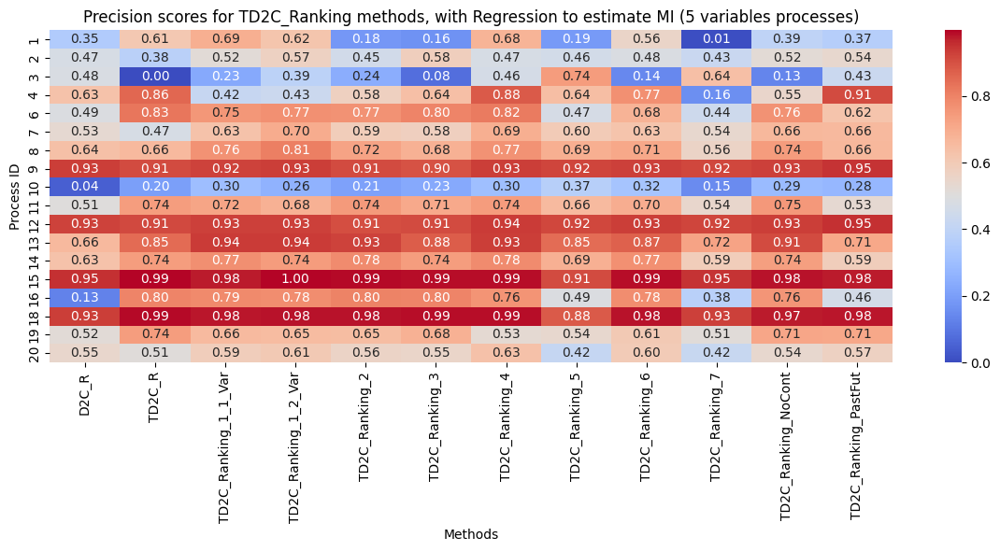

In [157]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_heatmap_TD2C_Ranking.pdf')

plt.show()

In [158]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'Precision'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,Precision
0,1,0.400852
1,2,0.489881
2,3,0.331353
3,4,0.622127
4,6,0.683661
5,7,0.606737
6,8,0.700733
7,9,0.923662
8,10,0.246161
9,11,0.668631


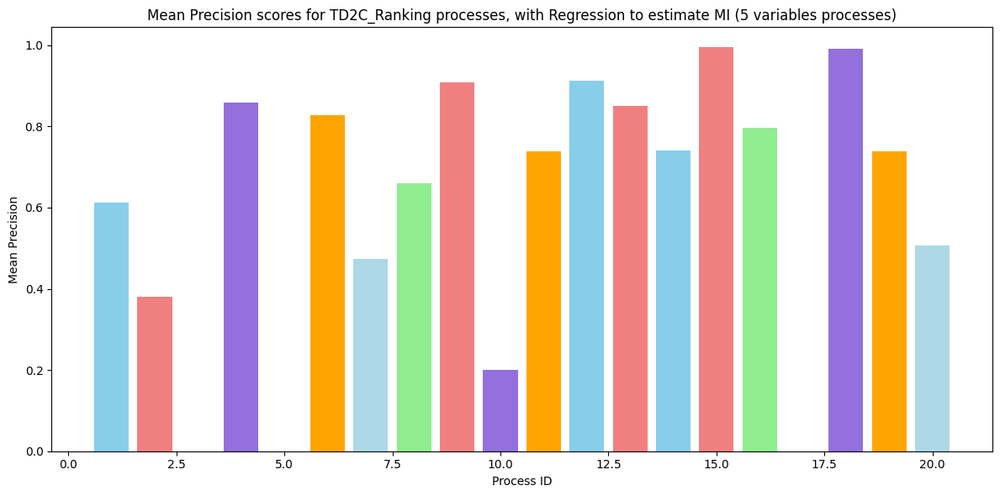

In [159]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean Precision scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean Precision')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [160]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'precision'})

df = df.sort_values(by='precision', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv', index=False)

df

,method,precision
1,TD2C_Ranking_4,0.738842
2,TD2C_Ranking_1_2_Var,0.711279
3,TD2C_Ranking_1_1_Var,0.698812
4,TD2C_Ranking_6,0.691457
5,TD2C_Ranking_NoCont,0.682190
6,TD2C_R,0.677154
7,TD2C_Ranking_2,0.666158
8,TD2C_Ranking_PastFut,0.661065
9,TD2C_Ranking_3,0.661021
10,TD2C_Ranking_5,0.634535


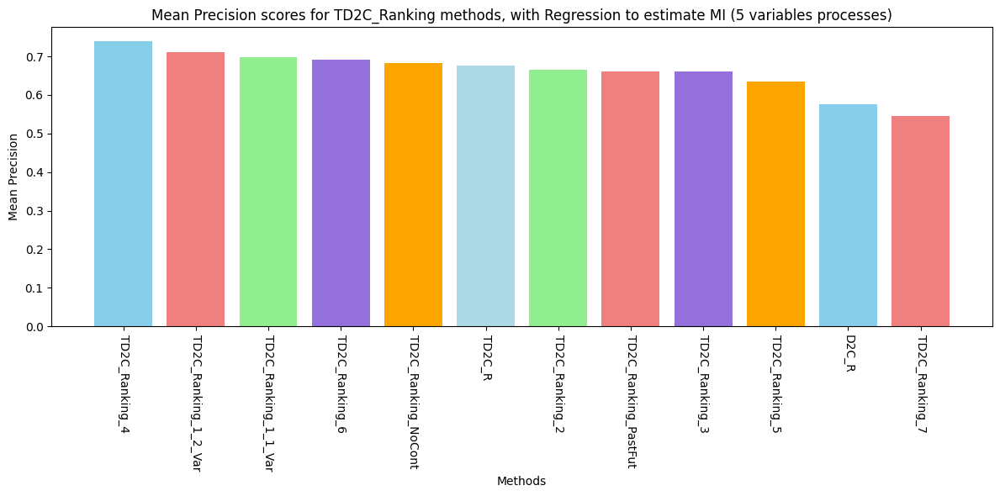

In [161]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['precision'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean Precision')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_barplot_TD2C_Ranking_avg.pdf')

plt.show()

### Recall

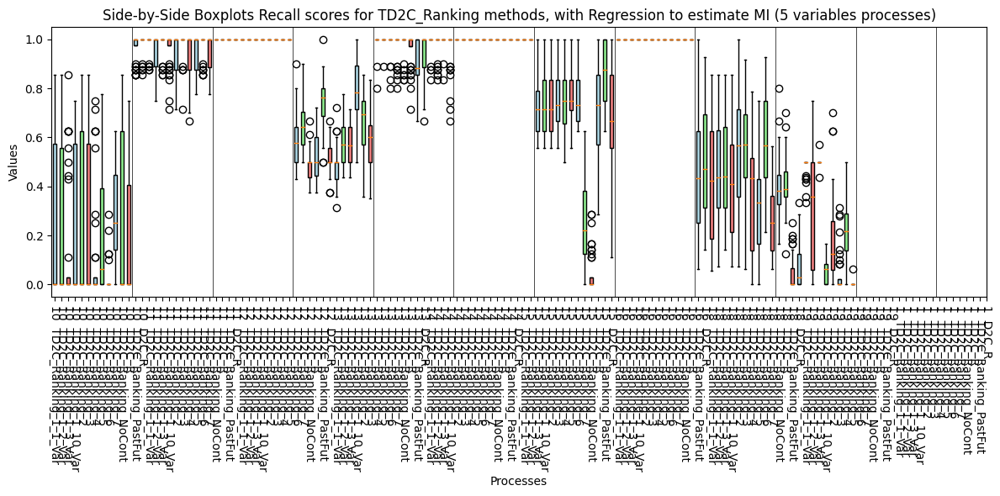

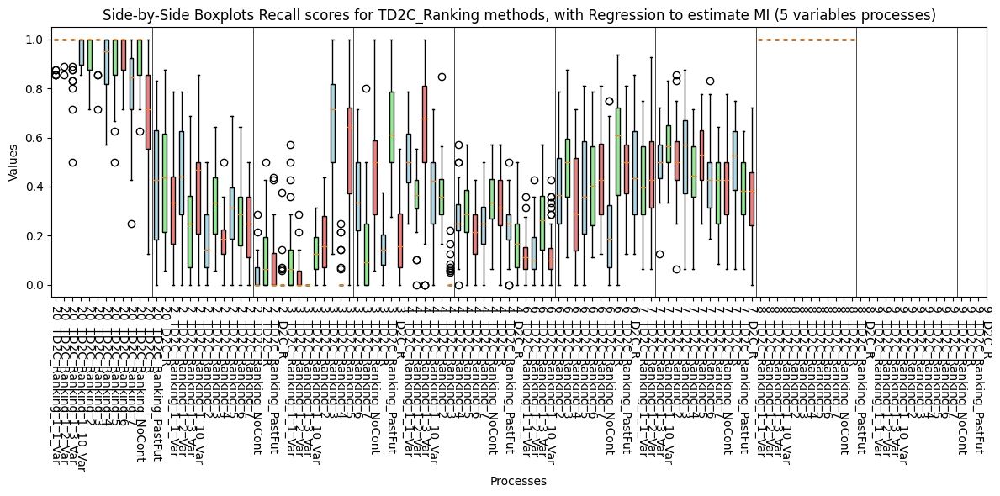

In [162]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)


# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

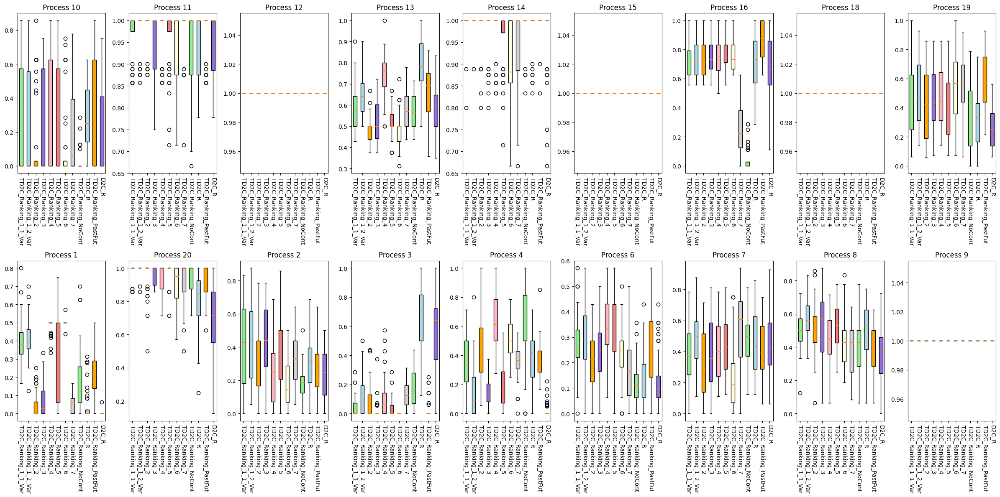

In [163]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)

# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



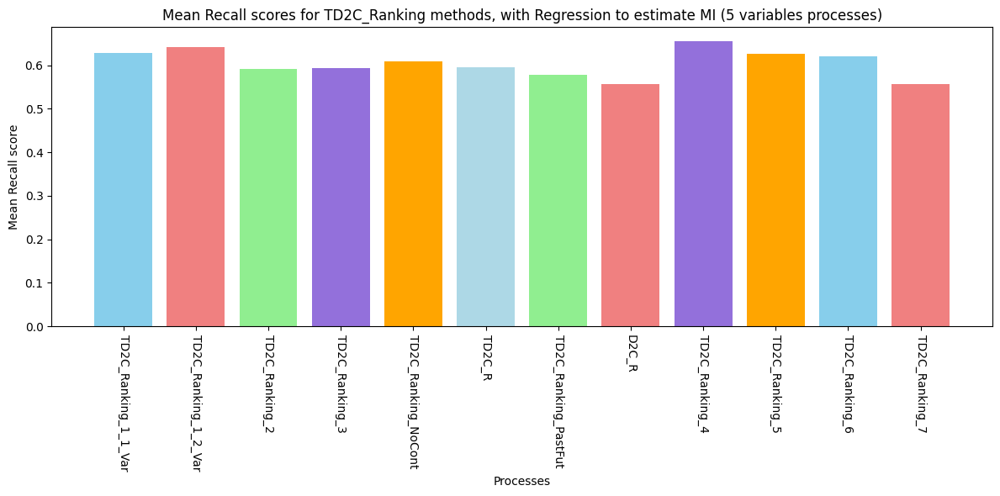

In [164]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)


# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean Recall score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [165]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)

                   

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='Recall')

df['Recall'] = df['Recall'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='Recall')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_recall_process': 'TD2C_+Ranking_1_1_Var_recall_process',
                        'TD2C_+Ranking_1_2_Var_recall_process': 'TD2C_+Ranking_1_2_Var_recall_process',
                        # 'TD2C_+Ranking_1_3_Var_recall_process': 'TD2C_+Ranking_1_3_Var_recall_process',
                        # 'TD2C_+Ranking_1_10_Var_recall_process': 'TD2C_+Ranking_1_10_Var_recall_process',
                        'TD2C_+Ranking_2_recall_process': 'TD2C_+Ranking_2_recall_process',
                        'TD2C_+Ranking_3_recall_process': 'TD2C_+Ranking_3_recall_process',
                        'TD2C_+Ranking_4_recall_process': 'TD2C_+Ranking_4_recall_process',
                        'TD2C_+Ranking_NoCont_recall_process': 'TD2C_+Ranking_NoCont_recall_process',
                        'TD2C_R_recall_process': 'TD2C_R_recall_process',
                        'TD2C_+Ranking_PastFut_recall_process': 'TD2C_+Ranking_PastFut_recall_process',
                        'D2C_R_recall_process': 'D2C_R_recall_process'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/4073572331.py:58: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.179653,0.500223,0.401334,0.411999,0.041553,0.074901,0.483656,0.042703,0.227178,0.001563,0.289861,0.049648
1,2,0.187649,0.183259,0.409524,0.439906,0.318403,0.442510,0.249628,0.308904,0.269147,0.229117,0.385913,0.320164
2,3,0.175694,0.000000,0.046379,0.127654,0.079092,0.019246,0.117336,0.662376,0.027455,0.560813,0.031076,0.121974
3,4,0.614945,0.515079,0.356255,0.156731,0.473770,0.146786,0.628046,0.373929,0.366811,0.022307,0.181592,0.352009
4,6,0.124678,0.229836,0.277381,0.297396,0.201637,0.249479,0.352331,0.129886,0.251984,0.130605,0.312525,0.172917
5,7,0.469742,0.237798,0.393155,0.484648,0.328100,0.382639,0.412525,0.442560,0.419643,0.449231,0.450620,0.543874
6,8,0.402604,0.413914,0.509821,0.582788,0.509077,0.537847,0.444916,0.497470,0.384053,0.365427,0.517758,0.391121
7,9,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,10,0.021448,0.116319,0.196815,0.190913,0.134921,0.184673,0.243294,0.290595,0.246220,0.174931,0.208065,0.196776
9,11,0.938879,0.941151,0.968284,0.982123,0.982917,0.959355,0.981052,0.942391,0.974633,0.953879,0.960992,0.980704


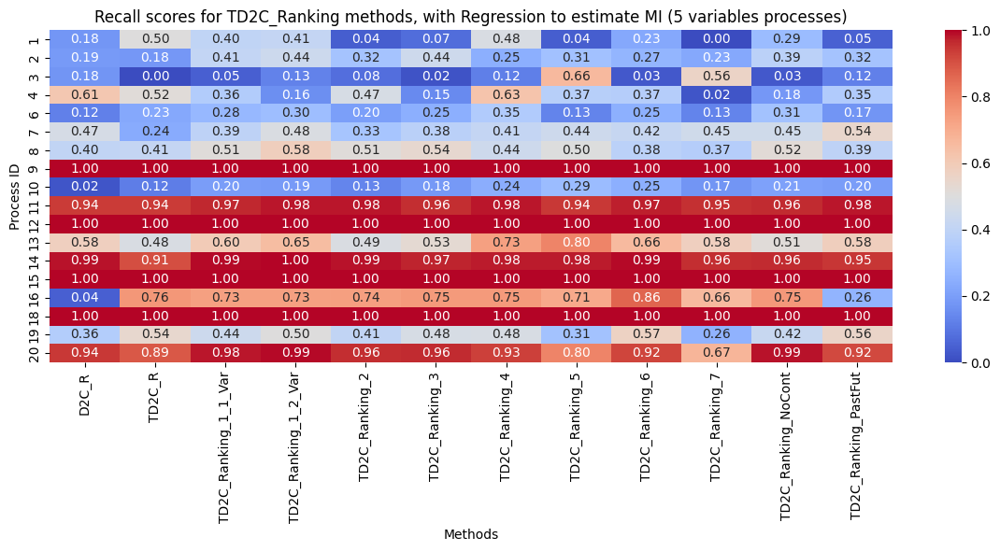

In [166]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_heatmap_TD2C_Ranking.pdf')

plt.show()

In [167]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'Recall'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,Recall
0,1,0.225356
1,2,0.312010
2,3,0.164091
3,4,0.349022
4,6,0.227555
5,7,0.417878
6,8,0.463066
7,9,1.000000
8,10,0.183748
9,11,0.963863


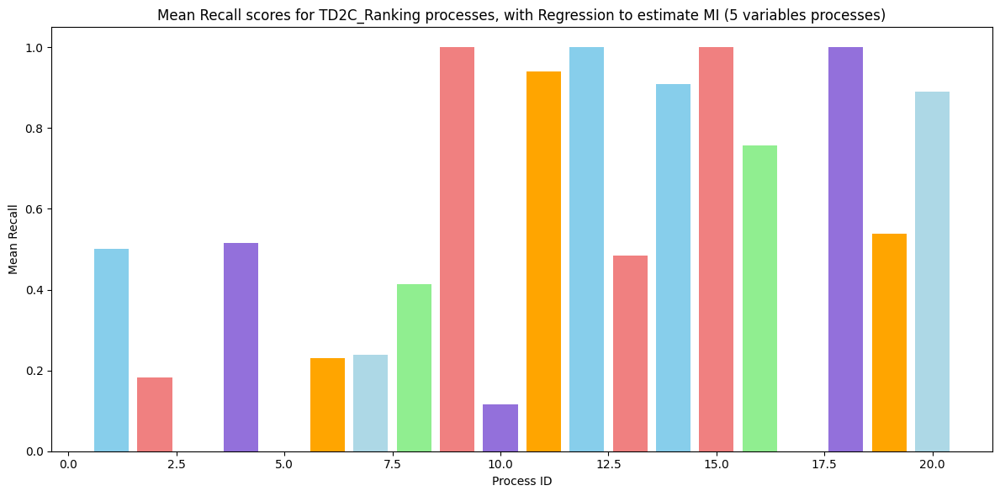

In [168]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean Recall scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean Recall')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [169]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'recall'})

df = df.sort_values(by='recall', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv', index=False)

df

,method,recall
1,TD2C_Ranking_4,0.654705
2,TD2C_Ranking_1_2_Var,0.641731
3,TD2C_Ranking_1_1_Var,0.627997
4,TD2C_Ranking_5,0.627104
5,TD2C_Ranking_6,0.620990
6,TD2C_Ranking_NoCont,0.609569
7,TD2C_R,0.595322
8,TD2C_Ranking_3,0.593743
9,TD2C_Ranking_2,0.591259
10,TD2C_Ranking_PastFut,0.577501


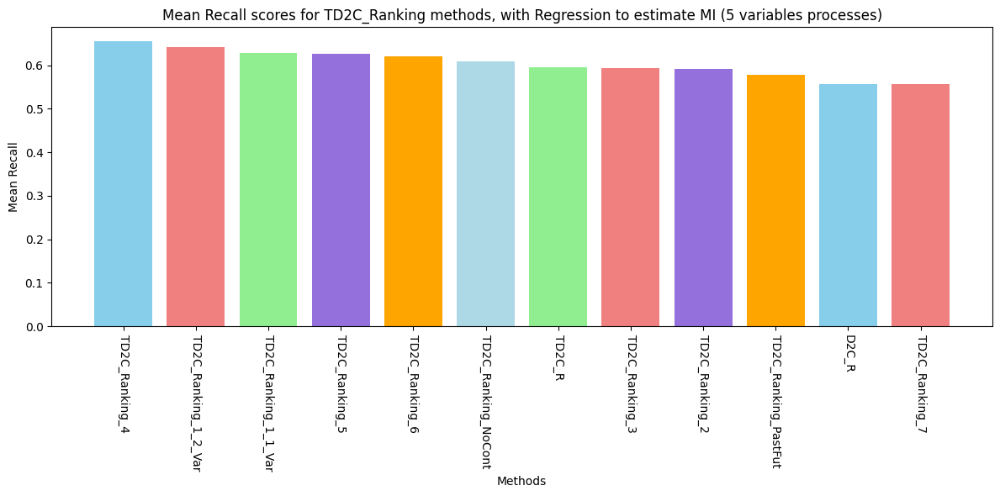

In [170]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['recall'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean Recall')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_barplot_TD2C_Ranking_avg.pdf')

plt.show()

### F1

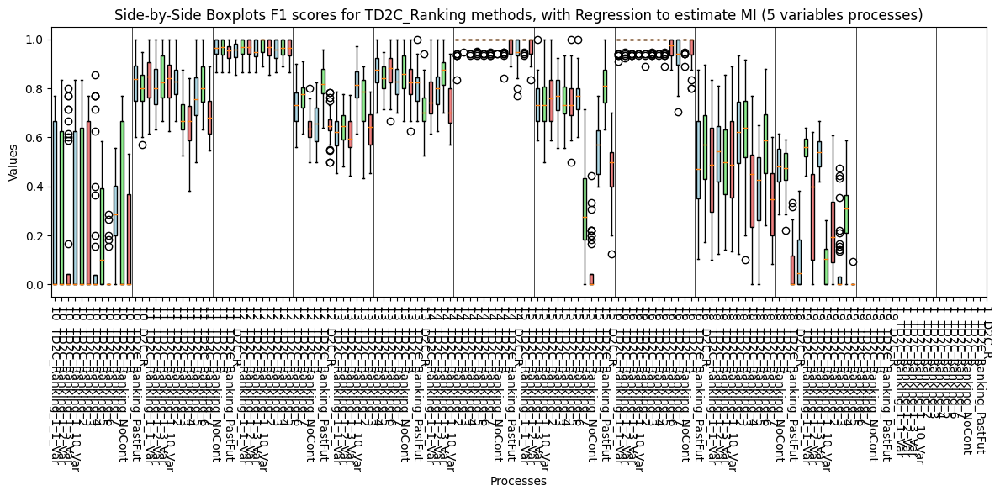

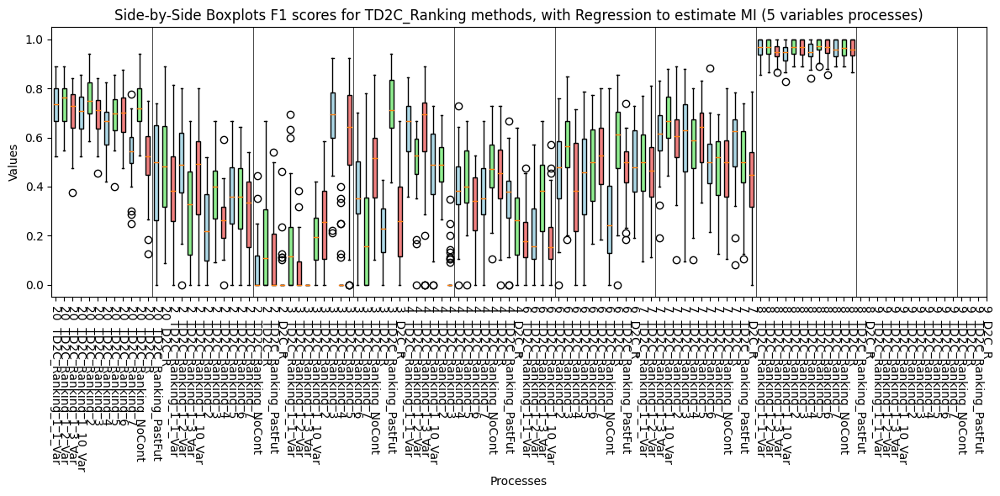

In [171]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)

# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

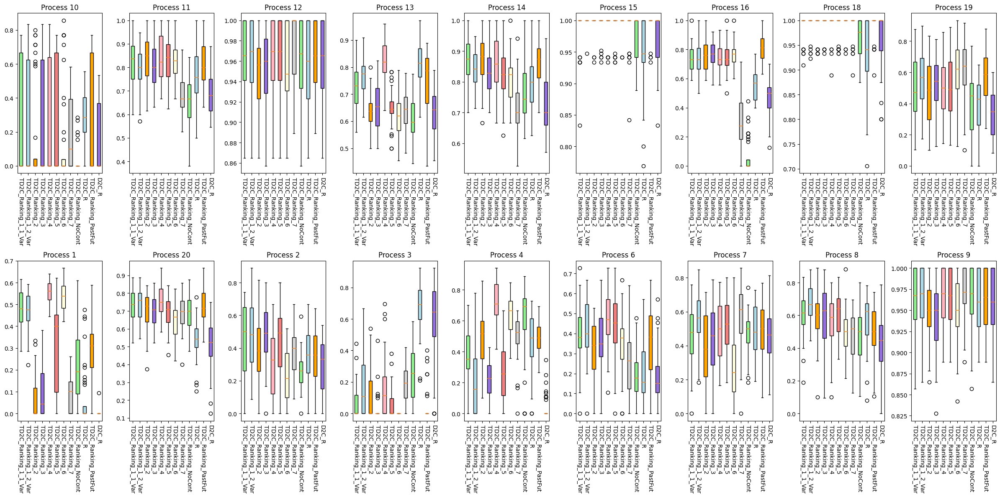

In [172]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)


# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



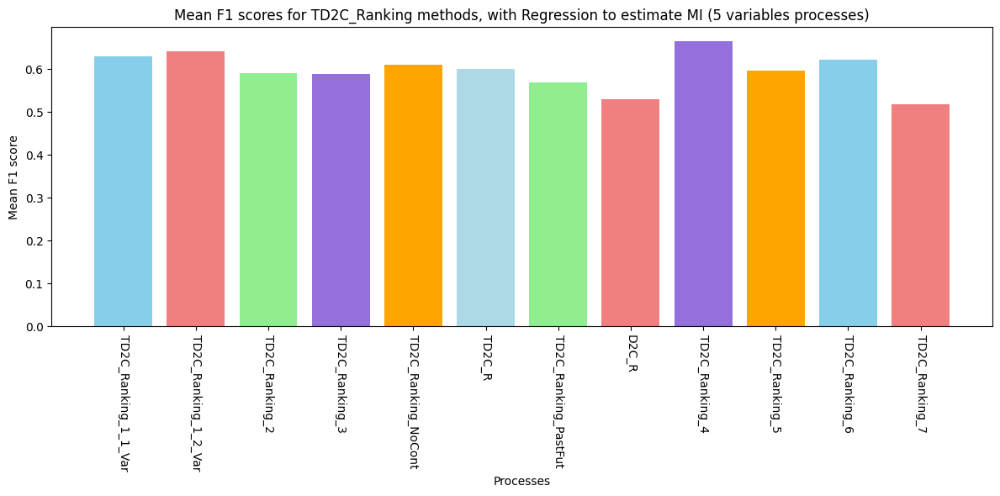

In [173]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)


# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean F1 score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [174]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='F1')

df['F1'] = df['F1'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='F1')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_f1_process': 'TD2C_+Ranking_1_1_Var_f1_process',
                        'TD2C_+Ranking_1_2_Var_f1_process': 'TD2C_+Ranking_1_2_Var_f1_process',
                        # 'TD2C_+Ranking_1_3_Var_f1_process': 'TD2C_+Ranking_1_3_Var_f1_process',
                        # 'TD2C_+Ranking_1_10_Var_f1_process': 'TD2C_+Ranking_1_10_Var_f1_process',
                        'TD2C_+Ranking_2_f1_process': 'TD2C_+Ranking_2_f1_process',
                        'TD2C_+Ranking_3_f1_process': 'TD2C_+Ranking_3_f1_process',
                        'TD2C_+Ranking_4_f1_process': 'TD2C_+Ranking_4_f1_process',
                        'TD2C_+Ranking_NoCont_f1_process': 'TD2C_+Ranking_NoCont_f1_process',
                        'TD2C_R_f1_process': 'TD2C_R_f1_process',
                        'TD2C_+Ranking_PastFut_f1_process': 'TD2C_+Ranking_PastFut_f1_process',
                        'D2C_R_f1_process': 'D2C_R_f1_process'})


# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/2778043241.py:56: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.216095,0.540865,0.482644,0.473677,0.061805,0.096058,0.555821,0.068445,0.302626,0.002381,0.308374,0.084419
1,2,0.259610,0.230352,0.439626,0.474047,0.361127,0.483096,0.312075,0.360734,0.337093,0.287394,0.427434,0.383449
2,3,0.247944,0.000000,0.075926,0.185582,0.112680,0.028601,0.176099,0.678931,0.045560,0.579416,0.048129,0.184577
3,4,0.610825,0.630310,0.375039,0.212884,0.501464,0.226886,0.712946,0.458028,0.484274,0.037164,0.258850,0.498363
4,6,0.193081,0.349930,0.397389,0.417802,0.309509,0.364571,0.483882,0.193801,0.355961,0.190893,0.435177,0.259939
5,7,0.479637,0.295407,0.462670,0.555141,0.395062,0.433053,0.489928,0.482162,0.485824,0.458613,0.517075,0.570894
6,8,0.480524,0.497574,0.604253,0.670576,0.586697,0.590041,0.554045,0.569643,0.490520,0.427806,0.600025,0.480915
7,9,0.963947,0.950398,0.959826,0.963590,0.952231,0.945386,0.964492,0.957382,0.961551,0.955288,0.961853,0.973255
8,10,0.027201,0.140540,0.225435,0.214274,0.160100,0.203636,0.263499,0.289166,0.261994,0.149238,0.236139,0.195643
9,11,0.650531,0.819603,0.817711,0.797829,0.838343,0.808224,0.836857,0.762696,0.805068,0.685602,0.836233,0.683880


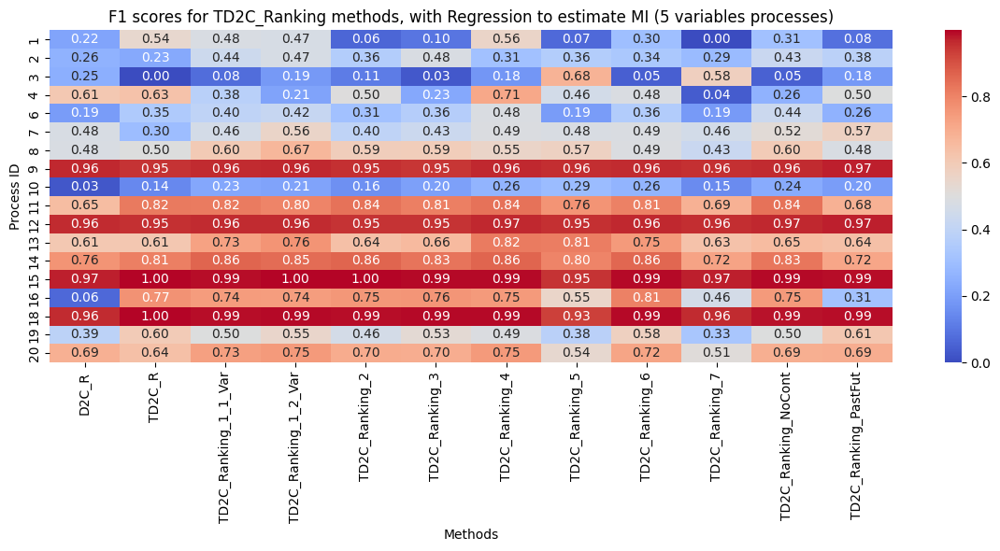

In [175]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_heatmap_TD2C_Ranking.pdf')

plt.show()

In [176]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'F1'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,F1
0,1,0.266101
1,2,0.363003
2,3,0.196954
3,4,0.417253
4,6,0.329328
5,7,0.468789
6,8,0.546052
7,9,0.959100
8,10,0.197239
9,11,0.778548


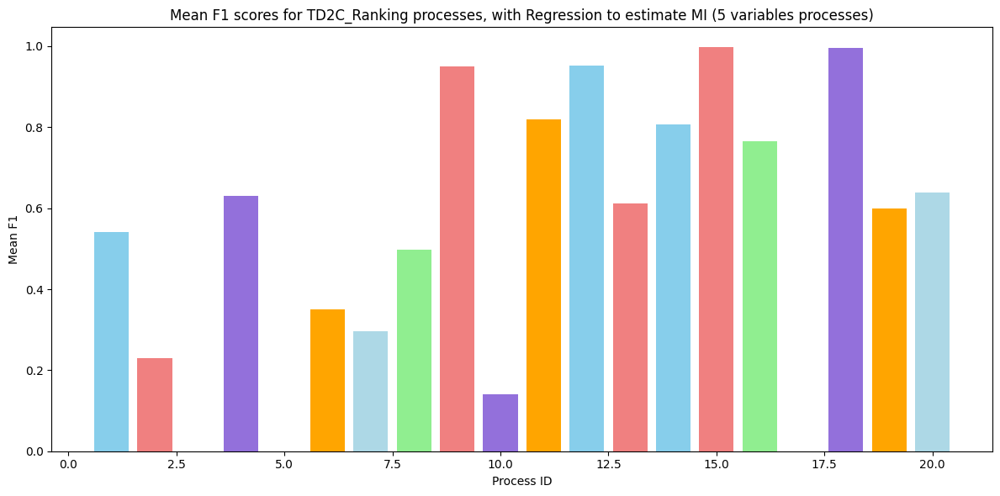

In [177]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean F1 scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean F1')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [178]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'f1'})

df = df.sort_values(by='f1', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv', index=False)

df

,method,f1
1,TD2C_Ranking_4,0.664577
2,TD2C_Ranking_1_2_Var,0.642530
3,TD2C_Ranking_1_1_Var,0.630039
4,TD2C_Ranking_6,0.621813
5,TD2C_Ranking_NoCont,0.610467
6,TD2C_R,0.601356
7,TD2C_Ranking_5,0.596607
8,TD2C_Ranking_2,0.590697
9,TD2C_Ranking_3,0.588289
10,TD2C_Ranking_PastFut,0.568871


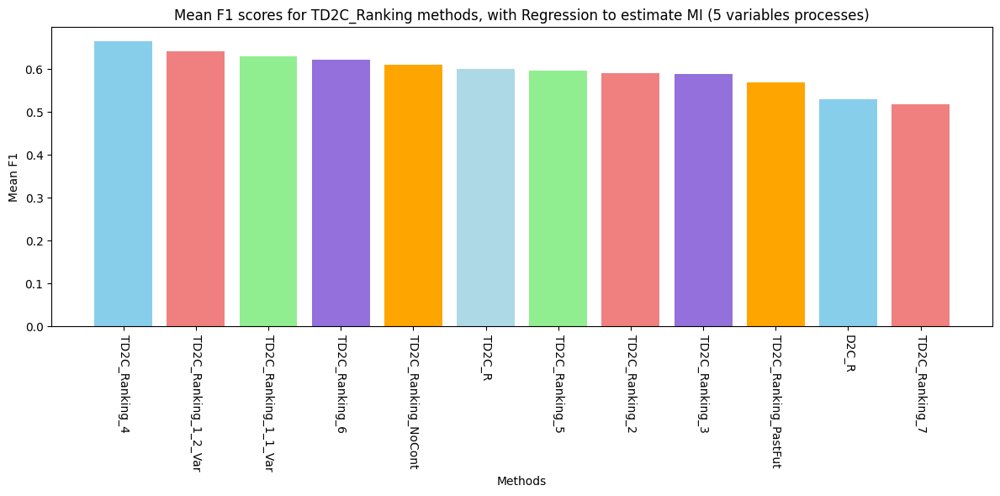

In [179]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['f1'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean F1')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_barplot_TD2C_Ranking_avg.pdf')

plt.show()

### PLOT SUMMARY - BEST METHOD OVERALL

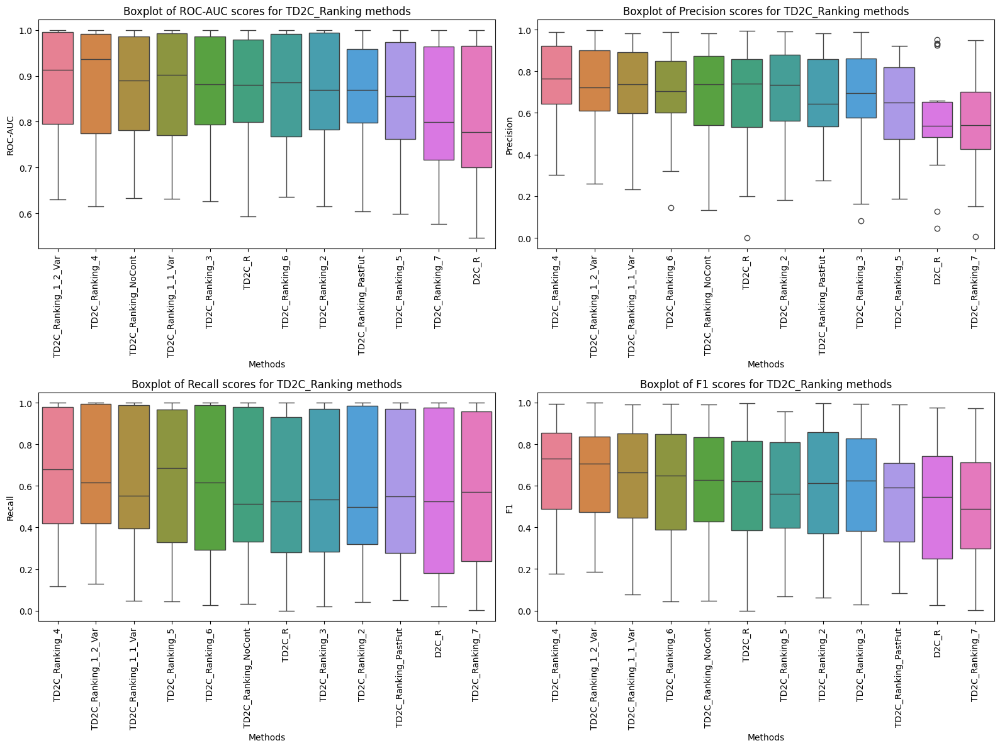

<Figure size 640x480 with 0 Axes>

In [327]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the DataFrames
df_r = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')
df_r_av = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')
df_p = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')
df_p_av = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')
df_rec = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')
df_rec_av = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')
df_f1 = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')
df_f1_av = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')

# Remove the first column
df_r = df_r.drop('Process ID', axis=1)
df_p = df_p.drop('Process ID', axis=1)
df_rec = df_rec.drop('Process ID', axis=1)
df_f1 = df_f1.drop('Process ID', axis=1)

# Sort the columns to match the order of the average DataFrames' rows
df_r = df_r[df_r_av['method']]
df_p = df_p[df_p_av['method']]
df_rec = df_rec[df_rec_av['method']]
df_f1 = df_f1[df_f1_av['method']]

# Create subplots
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Boxplot for ROC-AUC
sns.boxplot(data=df_r, orient='v', ax=axes[0, 0])
axes[0, 0].set_title('Boxplot of ROC-AUC scores for TD2C_Ranking methods')
axes[0, 0].set_xlabel('Methods')
axes[0, 0].set_ylabel('ROC-AUC')
axes[0, 0].tick_params(axis='x', rotation=90)

# Boxplot for Precision
sns.boxplot(data=df_p, orient='v', ax=axes[0, 1])
axes[0, 1].set_title('Boxplot of Precision scores for TD2C_Ranking methods')
axes[0, 1].set_xlabel('Methods')
axes[0, 1].set_ylabel('Precision')
axes[0, 1].tick_params(axis='x', rotation=90)

# Boxplot for Recall
sns.boxplot(data=df_rec, orient='v', ax=axes[1, 0])
axes[1, 0].set_title('Boxplot of Recall scores for TD2C_Ranking methods')
axes[1, 0].set_xlabel('Methods')
axes[1, 0].set_ylabel('Recall')
axes[1, 0].tick_params(axis='x', rotation=90)

# Boxplot for F1
sns.boxplot(data=df_f1, orient='v', ax=axes[1, 1])
axes[1, 1].set_title('Boxplot of F1 scores for TD2C_Ranking methods')
axes[1, 1].set_xlabel('Methods')
axes[1, 1].set_ylabel('F1')
axes[1, 1].tick_params(axis='x', rotation=90)

plt.tight_layout()
plt.show()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/boxplot_TD2C_all_metrics.pdf')

In [330]:
# top 5 methods for roc-auc
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')
df_r = df.head(8)

# for precision
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')
df_p = df.head(8)

# for recall
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')
df_re = df.head(8)

# for f1
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')
df_f = df.head(8)

# merge the dataframes
df = pd.merge(df_r, df_p, on='method')
df = pd.merge(df, df_re, on='method')
df = pd.merge(df, df_f, on='method')

df = df.rename(columns={'roc_auc': 'ROC-AUC', 'precision': 'Precision', 'recall': 'Recall', 'f1': 'F1'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/top_td2c_methods_merged.csv', index=False)

df # these methods are in the top 5 for all metrics


,method,ROC-AUC,Precision,Recall,F1
0,TD2C_Ranking_1_2_Var,0.883526,0.711279,0.641731,0.642530
1,TD2C_Ranking_4,0.880354,0.738842,0.654705,0.664577
2,TD2C_Ranking_NoCont,0.874187,0.682190,0.609569,0.610467
3,TD2C_Ranking_1_1_Var,0.873577,0.698812,0.627997,0.630039
4,TD2C_R,0.871846,0.677154,0.595322,0.601356
5,TD2C_Ranking_6,0.867173,0.691457,0.620990,0.621813


In [260]:
# top 5 methods for roc-auc
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')
df_r = df.head(8)

# for precision
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')
df_p = df.head(8)

# for recall
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')
df_re = df.head(8)

# for f1
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')
df_f = df.head(8)

# combine the dataframes without merging
df = pd.concat([df_r, df_p, df_re, df_f])

df = df.reset_index(drop=True)

df = df.rename(columns={'roc_auc': 'ROC-AUC', 'precision': 'Precision', 'recall': 'Recall', 'f1': 'F1'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/top_td2c_methods.csv', index=False)

df # these methods are in the top 5 for at least one metric

,method,ROC-AUC,Precision,Recall,F1
0,TD2C_Ranking_1_2_Var,0.883526,NaN,NaN,NaN
1,TD2C_Ranking_4,0.880354,NaN,NaN,NaN
2,TD2C_Ranking_NoCont,0.874187,NaN,NaN,NaN
3,TD2C_Ranking_1_1_Var,0.873577,NaN,NaN,NaN
4,TD2C_Ranking_3,0.873380,NaN,NaN,NaN
5,TD2C_R,0.871846,NaN,NaN,NaN
6,TD2C_Ranking_6,0.867173,NaN,NaN,NaN
7,TD2C_Ranking_2,0.864079,NaN,NaN,NaN
8,TD2C_Ranking_4,NaN,0.738842,NaN,NaN
9,TD2C_Ranking_1_2_Var,NaN,0.711279,NaN,NaN


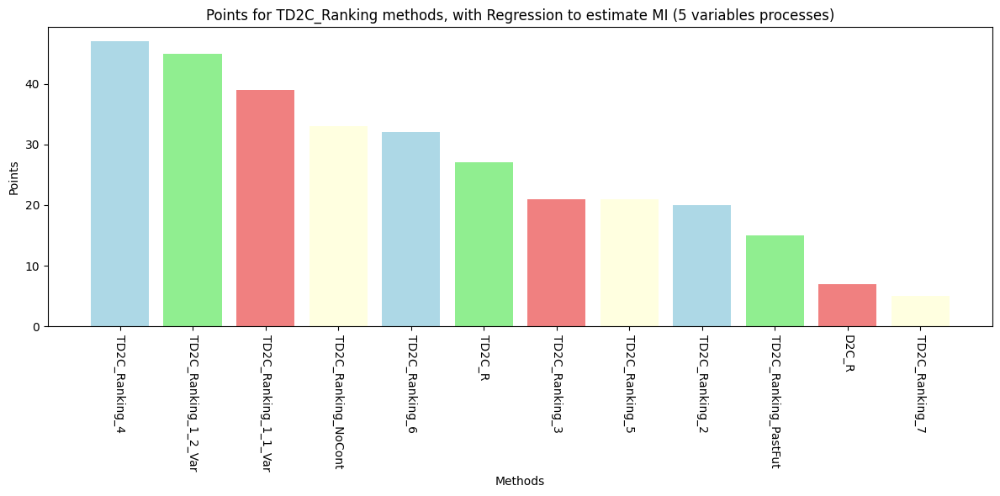

In [262]:
# # top 5 methods for roc-auc
df_r = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')
df_r['points_r'] = [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1]

# for precision
df_p = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')
df_p['points_p'] = [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1]

# for recall
df_re = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')
df_re['points_re'] = [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1]

# for f1
df_f = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')
df_f['points_f'] = [12, 11, 10, 9, 8, 7, 6, 5, 4, 3, 2, 1]

# merge the dataframes
df = pd.merge(df_r, df_p, on='method')
df = pd.merge(df, df_re, on='method')
df = pd.merge(df, df_f, on='method')

# sum the points for each method
df['points'] = df['points_r'] + df['points_p'] + df['points_re'] + df['points_f']

df = df.sort_values(by='points', ascending=False)

df = df.reset_index(drop=True)

# drop points_r, points_p, points_re, points_f columns
df = df.drop(columns=['points_r', 'points_p', 'points_re', 'points_f'])

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/top_td2c_methods_points.csv', index=False)

# plot the points for each method
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['points'], color=colors)
plt.xticks(rotation=-90)
plt.title('Points for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Points')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/top_td2c_methods_points.pdf')

plt.show()

In [274]:
# top 5 methods for roc-auc
df_r = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')
# for precision
df_p = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')
# for recall
df_re = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')
# for f1
df_f = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')

# merge the dataframes
df = pd.merge(df_r, df_p, on='method')
df = pd.merge(df, df_re, on='method')
df = pd.merge(df, df_f, on='method')

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/td2c_methods_all_metrics_merged.csv', index=False)

df


,method,roc_auc,precision,recall,f1
0,TD2C_Ranking_1_2_Var,0.883526,0.711279,0.641731,0.642530
1,TD2C_Ranking_4,0.880354,0.738842,0.654705,0.664577
2,TD2C_Ranking_NoCont,0.874187,0.682190,0.609569,0.610467
3,TD2C_Ranking_1_1_Var,0.873577,0.698812,0.627997,0.630039
4,TD2C_Ranking_3,0.873380,0.661021,0.593743,0.588289
5,TD2C_R,0.871846,0.677154,0.595322,0.601356
6,TD2C_Ranking_6,0.867173,0.691457,0.620990,0.621813
7,TD2C_Ranking_2,0.864079,0.666158,0.591259,0.590697
8,TD2C_Ranking_PastFut,0.859403,0.661065,0.577501,0.568871
9,TD2C_Ranking_5,0.853142,0.634535,0.627104,0.596607


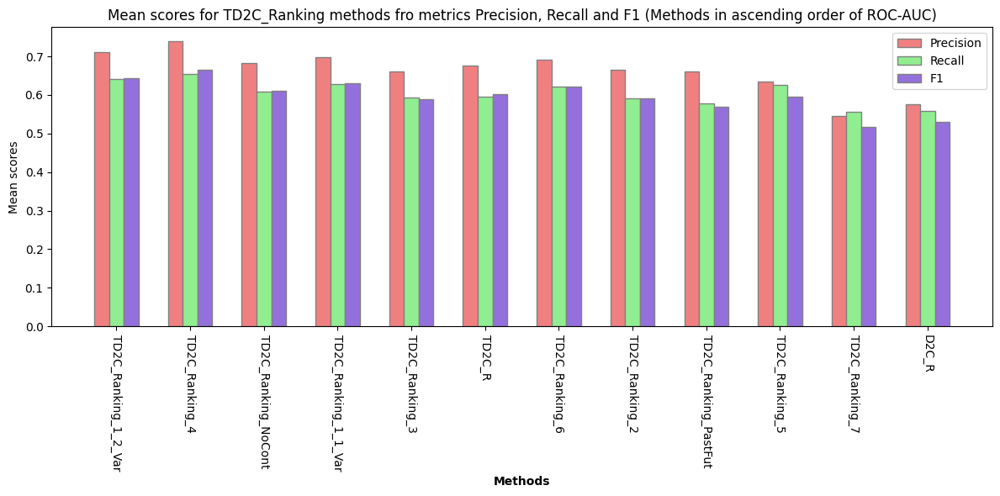

In [251]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load the DataFrames
df_r = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')
df_p = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')
df_re = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')
df_f = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')

# Merge the DataFrames on 'method'
df = pd.merge(df_r, df_p, on='method')
df = pd.merge(df, df_re, on='method')
df = pd.merge(df, df_f, on='method')

# Rename columns for clarity
df = df.rename(columns={'roc_auc': 'ROC-AUC', 'precision': 'Precision', 'recall': 'Recall', 'f1': 'F1'})

# Number of methods
n_methods = len(df['method'])

# Positions of the bars on the x-axis
bar_width = 0.2
r1 = np.arange(n_methods)
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Plotting Barplot for methods with separated bars
plt.figure(figsize=(12, 6))
plt.bar(r1, df['Precision'], color='lightcoral', width=bar_width, edgecolor='grey', label='Precision')
plt.bar(r2, df['Recall'], color='lightgreen', width=bar_width, edgecolor='grey', label='Recall')
plt.bar(r3, df['F1'], color='mediumpurple', width=bar_width, edgecolor='grey', label='F1')

# Adding xticks
plt.xlabel('Methods', fontweight='bold')
plt.xticks([r + bar_width for r in range(n_methods)], df['method'], rotation=-90)

plt.title('Mean scores for TD2C_Ranking methods fro metrics Precision, Recall and F1 (Methods in ascending order of ROC-AUC)')
plt.ylabel('Mean scores')
plt.legend(loc='upper right')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/top_td2c_methods_all_metrics_separated.pdf')

plt.show()

## KNNCMI for MI estimation (FOLDERS TO CHANGE)

### ROC-AUC

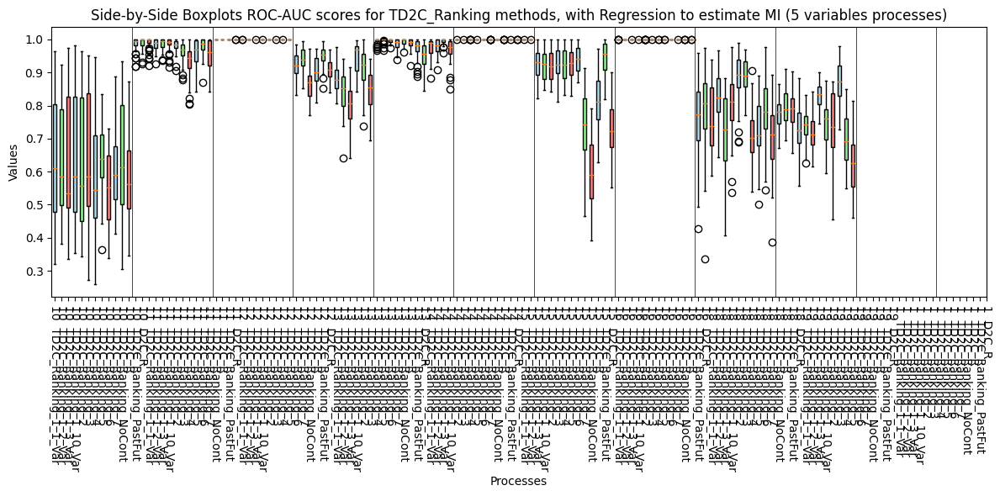

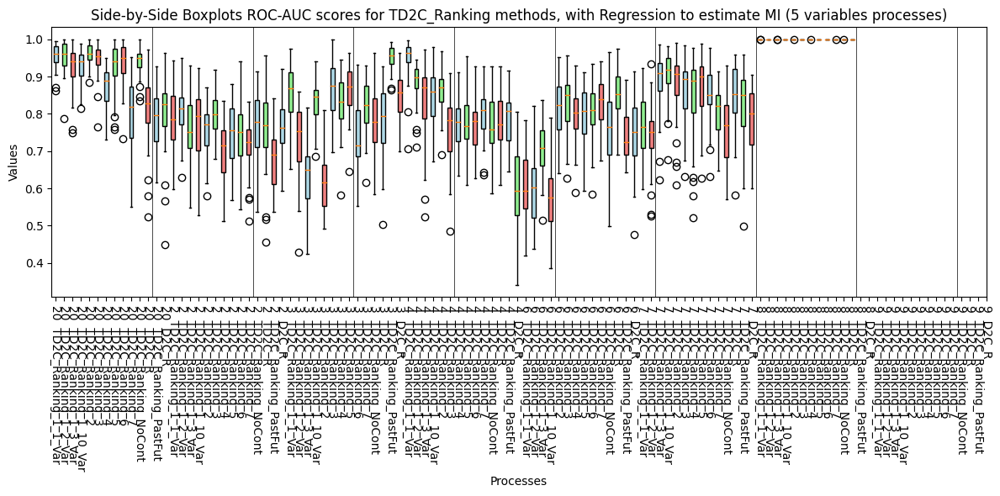

In [ ]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_rocs_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

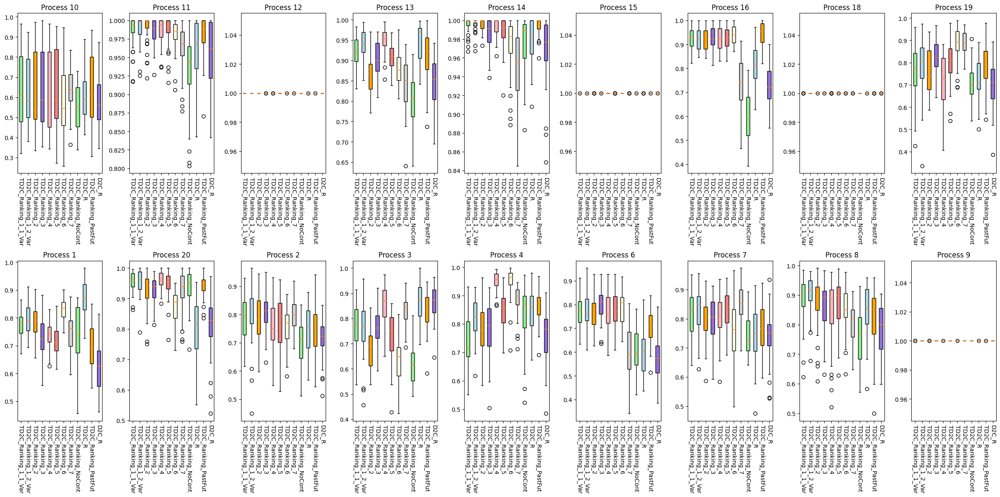

In [ ]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_rocs_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocouc_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



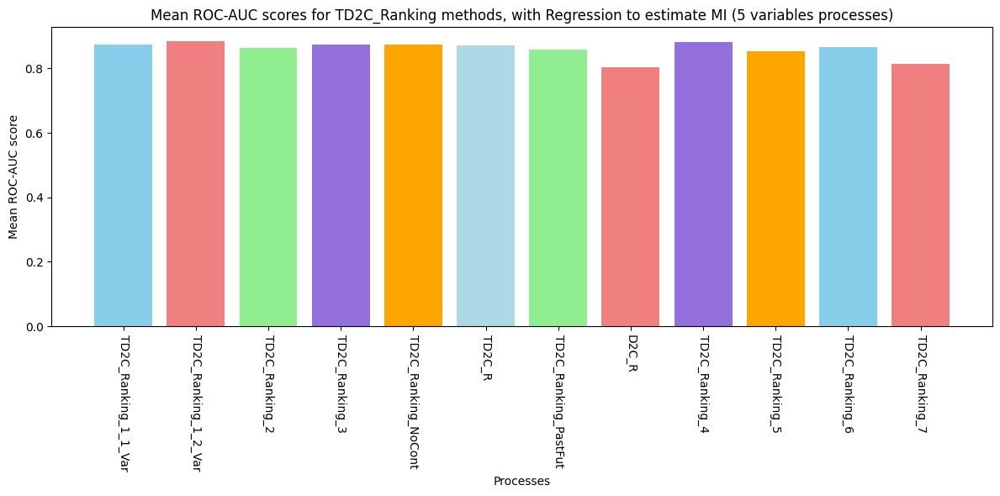

In [ ]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean ROC-AUC score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [ ]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_rocs_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_rocs_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_rocs_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_rocs_process)
df5 = pd.DataFrame(TD2C_Ranking_2_rocs_process)
df6 = pd.DataFrame(TD2C_Ranking_3_rocs_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_rocs_process)
df8 = pd.DataFrame(TD2C_rocs_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_rocs_process)
df10 = pd.DataFrame(D2C_rocs_process)
df11 = pd.DataFrame(TD2C_Ranking_4_rocs_process)
df12 = pd.DataFrame(TD2C_Ranking_5_rocs_process)
df13 = pd.DataFrame(TD2C_Ranking_6_rocs_process)
df14 = pd.DataFrame(TD2C_Ranking_7_rocs_process)

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='roc_auc')

df['roc_auc'] = df['roc_auc'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='roc_auc')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_rocs_process': 'TD2C_+Ranking_1_1_Var_rocs_process', 
                        'TD2C_+Ranking_1_2_Var_rocs_process': 'TD2C_+Ranking_1_2_Var_rocs_process', 
                        # 'TD2C_+Ranking_1_3_Var_rocs_process': 'TD2C_+Ranking_1_3_Var_rocs_process',
                        # 'TD2C_+Ranking_1_10_Var_rocs_process': 'TD2C_+Ranking_1_10_Var_rocs_process', 
                        'TD2C_+Ranking_2_rocs_process': 'TD2C_+Ranking_2_rocs_process', 
                        'TD2C_+Ranking_3_rocs_process': 'TD2C_+Ranking_3_rocs_process',
                        'TD2C_+Ranking_4_rocs_process': 'TD2C_+Ranking_4_rocs_process', 
                        'TD2C_+Ranking_NoCont_rocs_process': 'TD2C_+Ranking_NoCont_rocs_process',
                        'TD2C_R_rocs_process': 'TD2C_R_rocs_process',
                        'TD2C_+Ranking_PastFut_rocs_process': 'TD2C_+Ranking_PastFut_rocs_process',
                        'D2C_R_rocs_process': 'D2C_R_rocs_process'})

# eliminate the column method and make the process_id the index of the dataframe



# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/1535410291.py:56: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.739713,0.831485,0.776474,0.792724,0.786540,0.728764,0.738762,0.872446,0.695454,0.625059,0.721796,0.744201
1,2,0.699584,0.762302,0.785803,0.801894,0.787708,0.804403,0.751823,0.748472,0.744452,0.714935,0.770985,0.796404
2,3,0.619943,0.640468,0.767228,0.762528,0.680382,0.763604,0.855596,0.862550,0.824647,0.865537,0.730545,0.833735
3,4,0.824904,0.948410,0.737984,0.823518,0.782313,0.788145,0.950989,0.847511,0.860338,0.764641,0.849227,0.883992
4,6,0.606133,0.788516,0.768994,0.772028,0.768492,0.802143,0.766983,0.605880,0.706710,0.576266,0.775122,0.603968
5,7,0.743818,0.755143,0.821000,0.829179,0.798978,0.791879,0.798718,0.743801,0.761630,0.738880,0.831707,0.853853
6,8,0.753271,0.850260,0.882939,0.904632,0.873245,0.862437,0.842162,0.849258,0.820393,0.788382,0.870937,0.802810
7,9,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,10,0.546480,0.592764,0.632131,0.629828,0.615599,0.625865,0.615933,0.598305,0.636053,0.580792,0.632631,0.641167
9,11,0.932885,0.981141,0.985230,0.988471,0.989112,0.985222,0.985297,0.959235,0.979821,0.951416,0.985314,0.962049


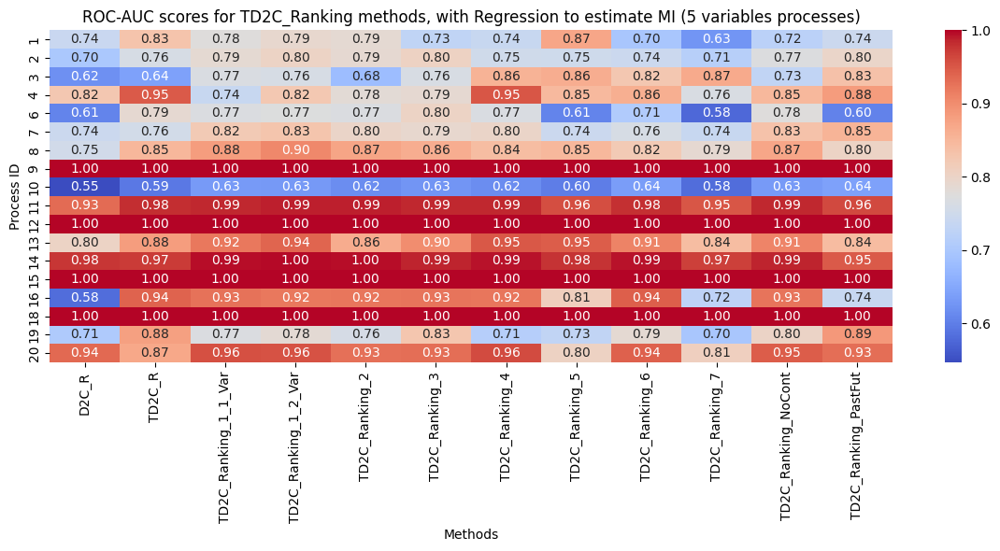

In [ ]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_heatmap_TD2C_Ranking.pdf')

plt.show()

In [ ]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'roc_auc'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,roc_auc
0,1,0.754452
1,2,0.764064
2,3,0.767230
3,4,0.838498
4,6,0.711770
5,7,0.789049
6,8,0.841727
7,9,1.000000
8,10,0.612296
9,11,0.973766


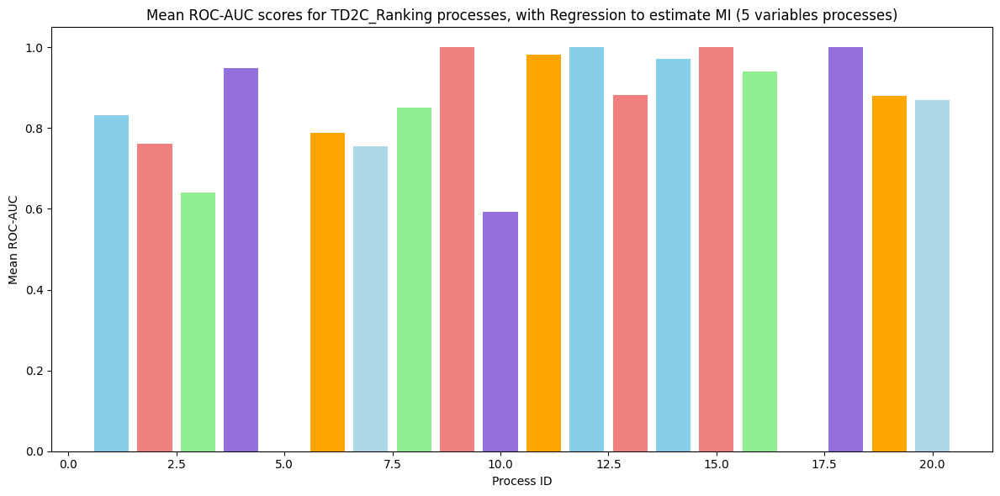

In [ ]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean ROC-AUC scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean ROC-AUC')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [ ]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'roc_auc'})

df = df.sort_values(by='roc_auc', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/rocauc_td2c_ranking_avg.csv', index=False)

df

,method,roc_auc
1,TD2C_Ranking_1_2_Var,0.883526
2,TD2C_Ranking_4,0.880354
3,TD2C_Ranking_NoCont,0.874187
4,TD2C_Ranking_1_1_Var,0.873577
5,TD2C_Ranking_3,0.873380
6,TD2C_R,0.871846
7,TD2C_Ranking_6,0.867173
8,TD2C_Ranking_2,0.864079
9,TD2C_Ranking_PastFut,0.859403
10,TD2C_Ranking_5,0.853142


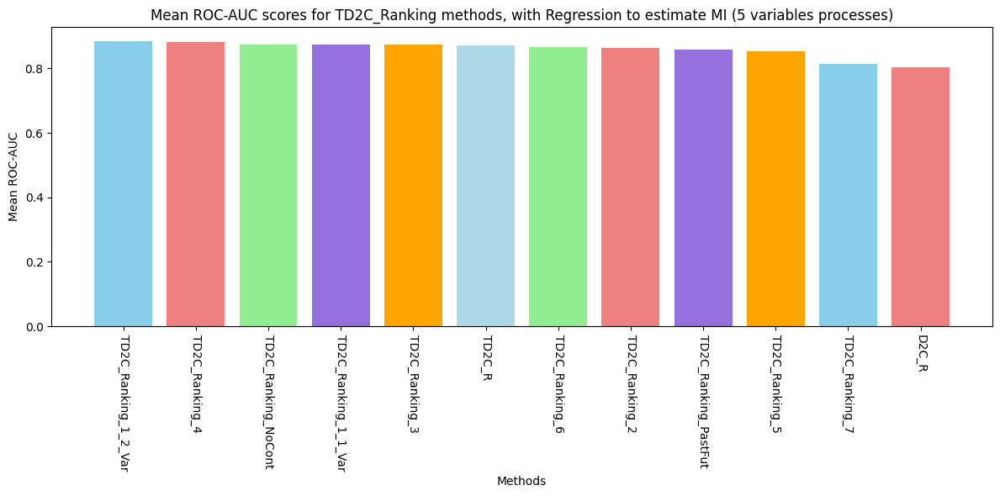

In [ ]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/roc_auc_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['roc_auc'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean ROC-AUC scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean ROC-AUC')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/rocauc_barplot_TD2C_Ranking_avg.pdf')

plt.show()

### Precision

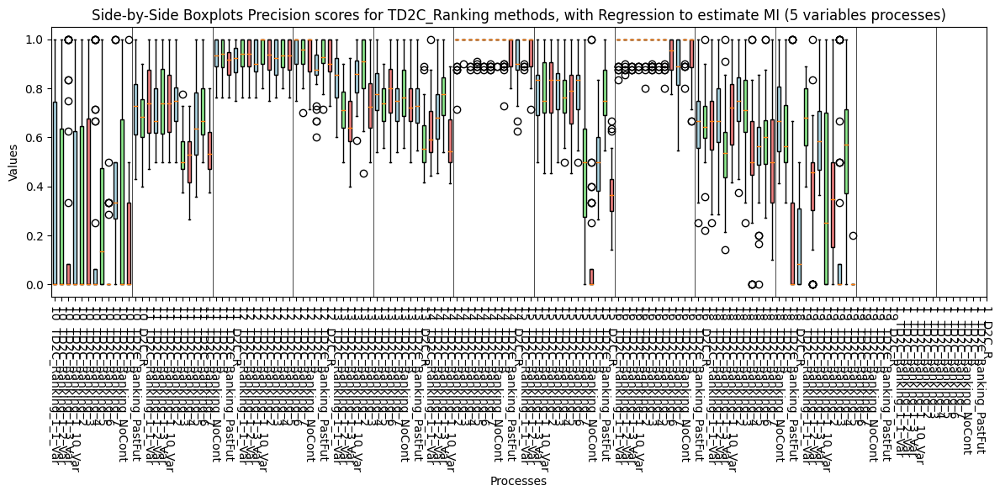

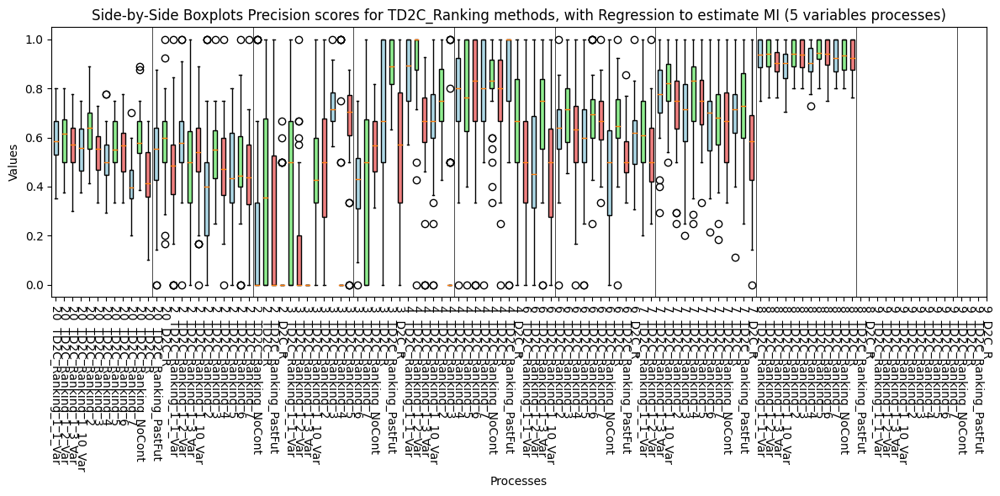

In [ ]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_precision_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)

# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

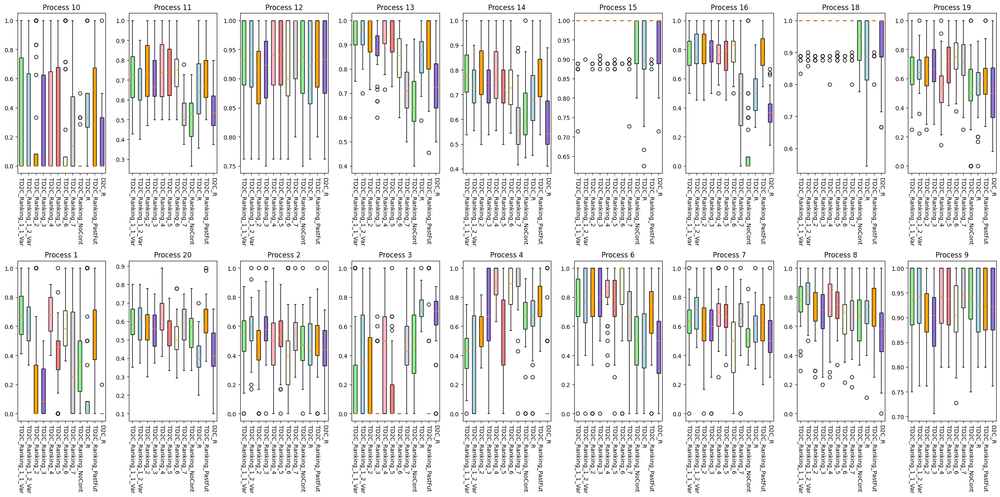

In [ ]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_precision_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)

# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



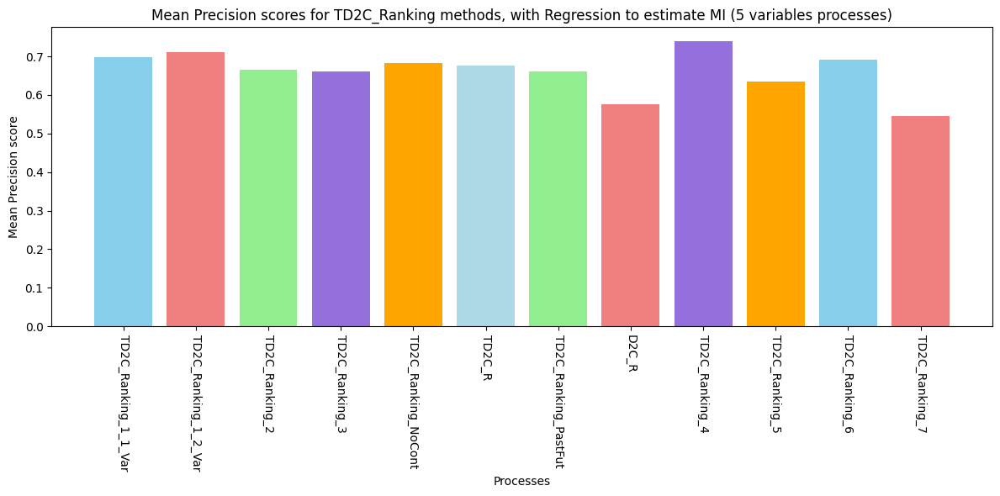

In [ ]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)


# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean Precision score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [ ]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_precision_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_precision_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_precision_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_precision_process)
df5 = pd.DataFrame(TD2C_Ranking_2_precision_process)
df6 = pd.DataFrame(TD2C_Ranking_3_precision_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_precision_process)
df8 = pd.DataFrame(TD2C_precision_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_precision_process)
df10 = pd.DataFrame(D2C_precision_process)
df11 = pd.DataFrame(TD2C_Ranking_4_precision_process)
df12 = pd.DataFrame(TD2C_Ranking_5_precision_process)
df13 = pd.DataFrame(TD2C_Ranking_6_precision_process)
df14 = pd.DataFrame(TD2C_Ranking_7_precision_process)

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='Precision')

df['Precision'] = df['Precision'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='Precision')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_precision_process': 'TD2C_+Ranking_1_1_Var_precision_process',
                        'TD2C_+Ranking_1_2_Var_precision_process': 'TD2C_+Ranking_1_2_Var_precision_process',
                        # 'TD2C_+Ranking_1_3_Var_precision_process': 'TD2C_+Ranking_1_3_Var_precision_process',
                        # 'TD2C_+Ranking_1_10_Var_precision_process': 'TD2C_+Ranking_1_10_Var_precision_process',
                        'TD2C_+Ranking_2_precision_process': 'TD2C_+Ranking_2_precision_process',
                        'TD2C_+Ranking_3_precision_process': 'TD2C_+Ranking_3_precision_process',
                        'TD2C_+Ranking_4_precision_process': 'TD2C_+Ranking_4_precision_process',
                        'TD2C_+Ranking_NoCont_precision_process': 'TD2C_+Ranking_NoCont_precision_process',
                        'TD2C_R_precision_process': 'TD2C_R_precision_process',
                        'TD2C_+Ranking_PastFut_precision_process': 'TD2C_+Ranking_PastFut_precision_process',
                        'D2C_R_precision_process': 'D2C_R_precision_process'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/29425775.py:56: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.351590,0.611294,0.691583,0.621413,0.181875,0.163841,0.677615,0.187500,0.555780,0.005000,0.393927,0.368810
1,2,0.472477,0.380730,0.517569,0.571711,0.453700,0.580793,0.472339,0.458175,0.484106,0.427567,0.518416,0.540990
2,3,0.479871,0.000000,0.231667,0.389018,0.241944,0.081667,0.464692,0.740705,0.143750,0.640505,0.133036,0.429375
3,4,0.627431,0.858614,0.420298,0.433449,0.575201,0.642083,0.881555,0.643166,0.770882,0.157500,0.547108,0.908234
4,6,0.490506,0.826607,0.754117,0.770027,0.765744,0.798065,0.816089,0.468056,0.681776,0.444196,0.763935,0.624812
5,7,0.532769,0.472624,0.628207,0.701290,0.591916,0.577363,0.691435,0.596447,0.625680,0.539732,0.663636,0.659743
6,8,0.637415,0.660033,0.763742,0.809555,0.721327,0.683438,0.767585,0.692821,0.711215,0.557925,0.740998,0.662747
7,9,0.932632,0.908214,0.924977,0.931677,0.911094,0.899412,0.933251,0.920170,0.927913,0.916717,0.928405,0.949482
8,10,0.044643,0.200298,0.299827,0.260982,0.209375,0.230060,0.301771,0.370261,0.321190,0.151811,0.287649,0.276061
9,11,0.505737,0.738926,0.720292,0.683246,0.744955,0.707604,0.743648,0.658339,0.696081,0.542591,0.751146,0.531013


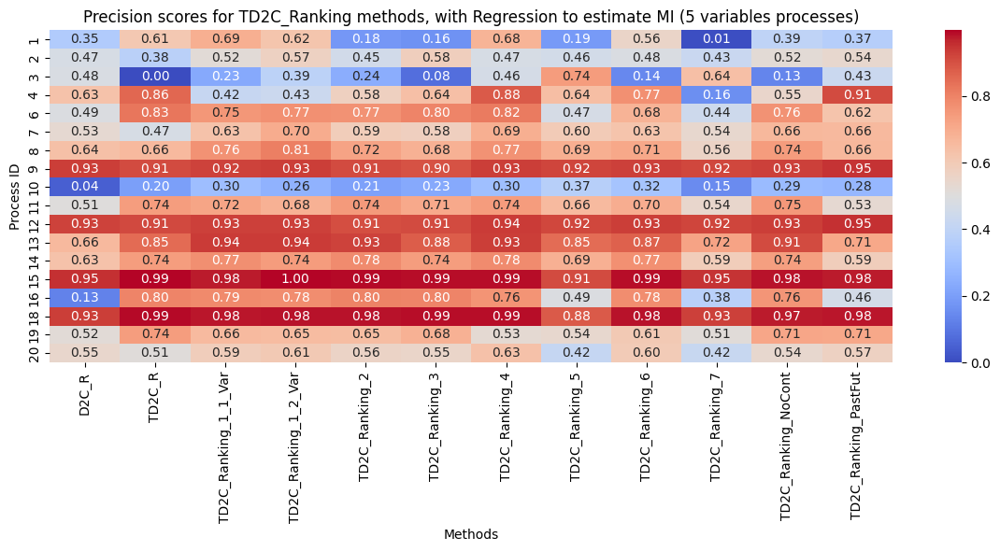

In [ ]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_heatmap_TD2C_Ranking.pdf')

plt.show()

In [ ]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'Precision'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,Precision
0,1,0.400852
1,2,0.489881
2,3,0.331353
3,4,0.622127
4,6,0.683661
5,7,0.606737
6,8,0.700733
7,9,0.923662
8,10,0.246161
9,11,0.668631


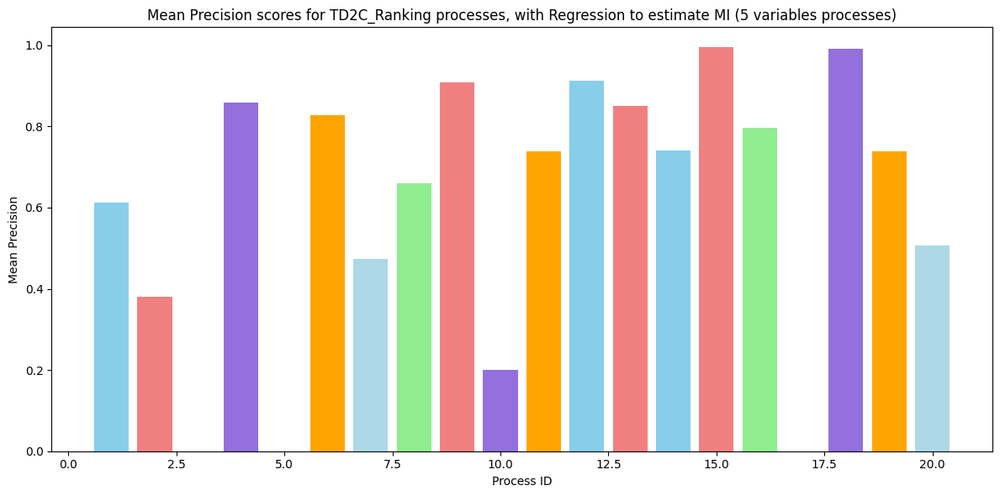

In [ ]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean Precision scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean Precision')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [ ]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'precision'})

df = df.sort_values(by='precision', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv', index=False)

df

,method,precision
1,TD2C_Ranking_4,0.738842
2,TD2C_Ranking_1_2_Var,0.711279
3,TD2C_Ranking_1_1_Var,0.698812
4,TD2C_Ranking_6,0.691457
5,TD2C_Ranking_NoCont,0.682190
6,TD2C_R,0.677154
7,TD2C_Ranking_2,0.666158
8,TD2C_Ranking_PastFut,0.661065
9,TD2C_Ranking_3,0.661021
10,TD2C_Ranking_5,0.634535


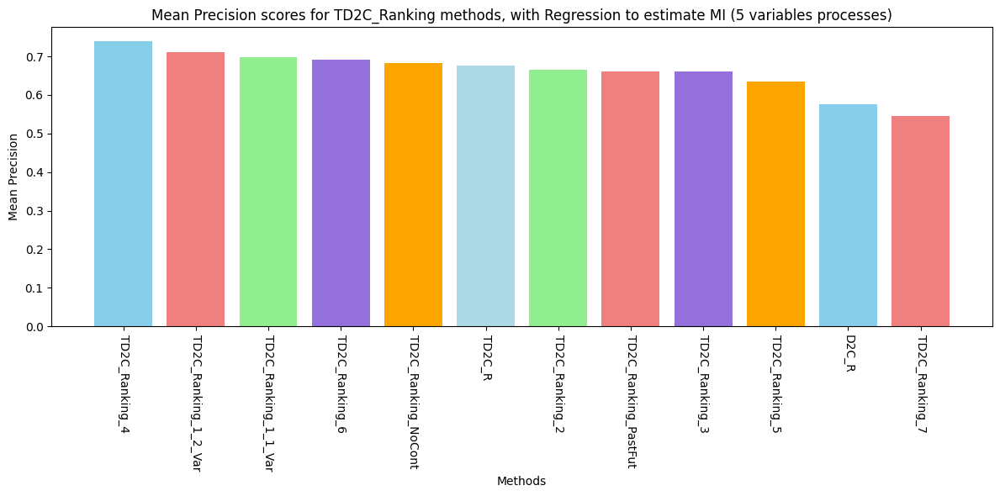

In [ ]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/precision_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['precision'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Precision scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean Precision')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/precision_barplot_TD2C_Ranking_avg.pdf')

plt.show()

### Recall

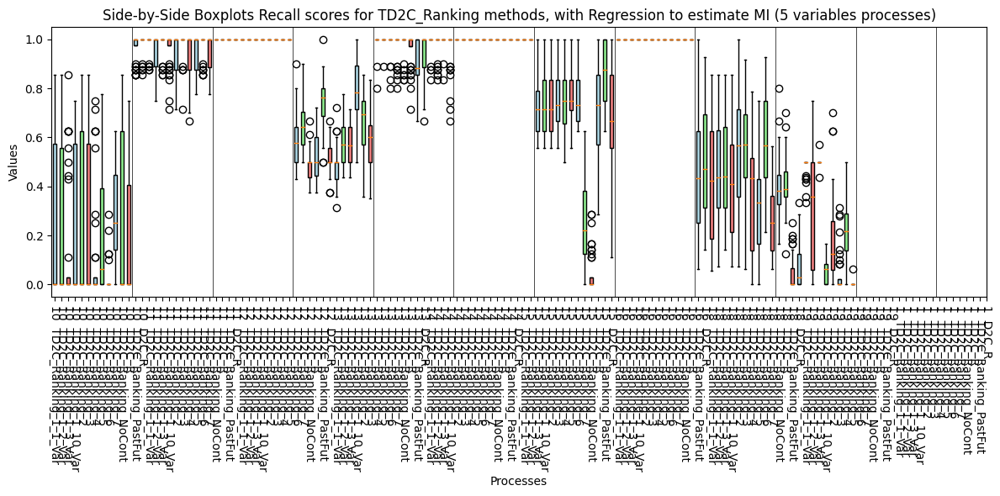

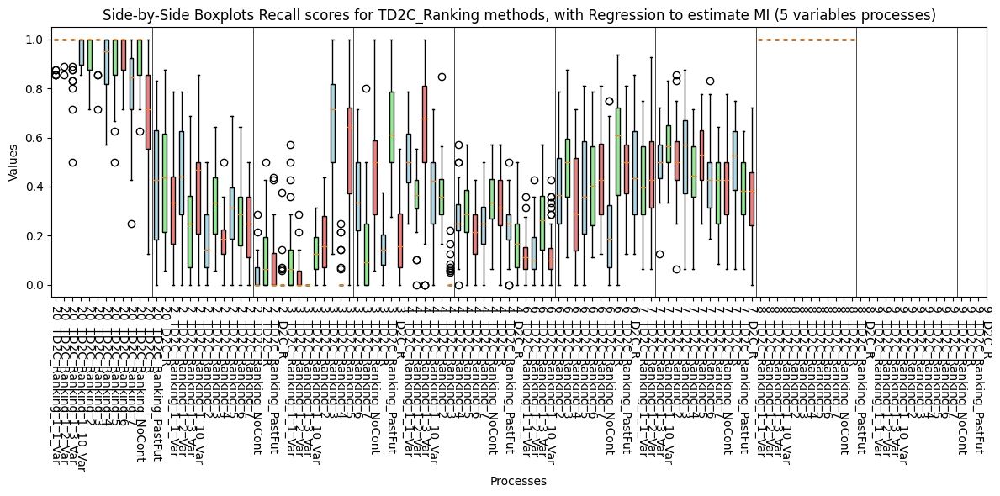

In [ ]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)


# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

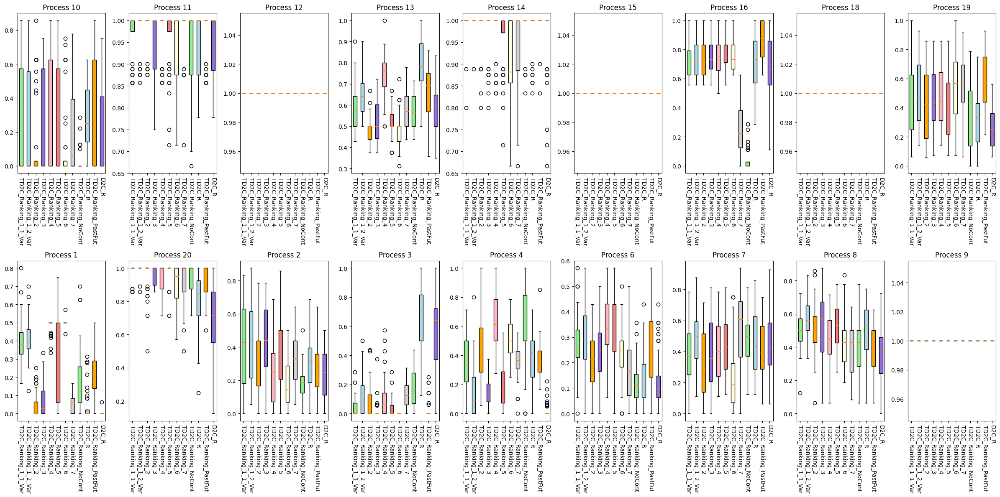

In [ ]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)

# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



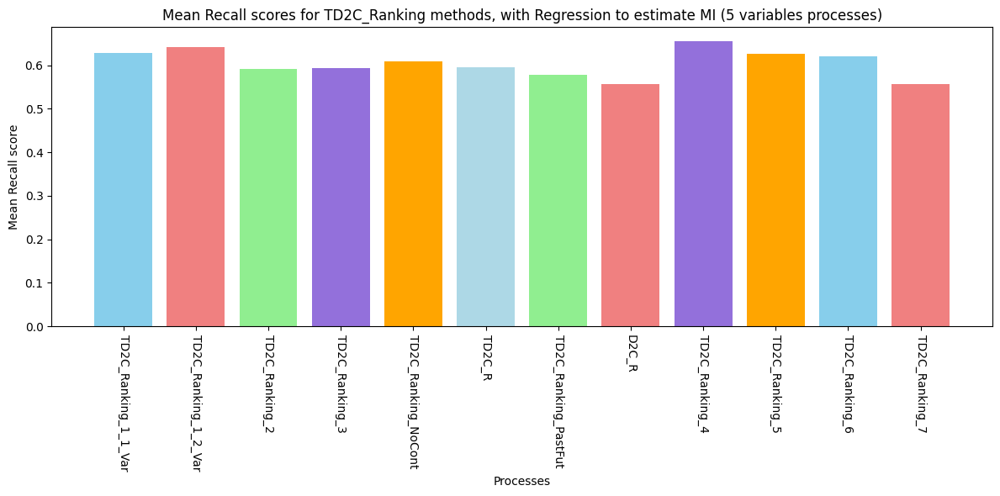

In [ ]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)


# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean Recall score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [ ]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_recall_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_recall_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_recall_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_recall_process)
df5 = pd.DataFrame(TD2C_Ranking_2_recall_process)
df6 = pd.DataFrame(TD2C_Ranking_3_recall_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_recall_process)
df8 = pd.DataFrame(TD2C_recall_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_recall_process)
df10 = pd.DataFrame(D2C_recall_process)
df11 = pd.DataFrame(TD2C_Ranking_4_recall_process)
df12 = pd.DataFrame(TD2C_Ranking_5_recall_process)
df13 = pd.DataFrame(TD2C_Ranking_6_recall_process)
df14 = pd.DataFrame(TD2C_Ranking_7_recall_process)

                   

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='Recall')

df['Recall'] = df['Recall'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='Recall')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_recall_process': 'TD2C_+Ranking_1_1_Var_recall_process',
                        'TD2C_+Ranking_1_2_Var_recall_process': 'TD2C_+Ranking_1_2_Var_recall_process',
                        # 'TD2C_+Ranking_1_3_Var_recall_process': 'TD2C_+Ranking_1_3_Var_recall_process',
                        # 'TD2C_+Ranking_1_10_Var_recall_process': 'TD2C_+Ranking_1_10_Var_recall_process',
                        'TD2C_+Ranking_2_recall_process': 'TD2C_+Ranking_2_recall_process',
                        'TD2C_+Ranking_3_recall_process': 'TD2C_+Ranking_3_recall_process',
                        'TD2C_+Ranking_4_recall_process': 'TD2C_+Ranking_4_recall_process',
                        'TD2C_+Ranking_NoCont_recall_process': 'TD2C_+Ranking_NoCont_recall_process',
                        'TD2C_R_recall_process': 'TD2C_R_recall_process',
                        'TD2C_+Ranking_PastFut_recall_process': 'TD2C_+Ranking_PastFut_recall_process',
                        'D2C_R_recall_process': 'D2C_R_recall_process'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/4073572331.py:58: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.179653,0.500223,0.401334,0.411999,0.041553,0.074901,0.483656,0.042703,0.227178,0.001563,0.289861,0.049648
1,2,0.187649,0.183259,0.409524,0.439906,0.318403,0.442510,0.249628,0.308904,0.269147,0.229117,0.385913,0.320164
2,3,0.175694,0.000000,0.046379,0.127654,0.079092,0.019246,0.117336,0.662376,0.027455,0.560813,0.031076,0.121974
3,4,0.614945,0.515079,0.356255,0.156731,0.473770,0.146786,0.628046,0.373929,0.366811,0.022307,0.181592,0.352009
4,6,0.124678,0.229836,0.277381,0.297396,0.201637,0.249479,0.352331,0.129886,0.251984,0.130605,0.312525,0.172917
5,7,0.469742,0.237798,0.393155,0.484648,0.328100,0.382639,0.412525,0.442560,0.419643,0.449231,0.450620,0.543874
6,8,0.402604,0.413914,0.509821,0.582788,0.509077,0.537847,0.444916,0.497470,0.384053,0.365427,0.517758,0.391121
7,9,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,10,0.021448,0.116319,0.196815,0.190913,0.134921,0.184673,0.243294,0.290595,0.246220,0.174931,0.208065,0.196776
9,11,0.938879,0.941151,0.968284,0.982123,0.982917,0.959355,0.981052,0.942391,0.974633,0.953879,0.960992,0.980704


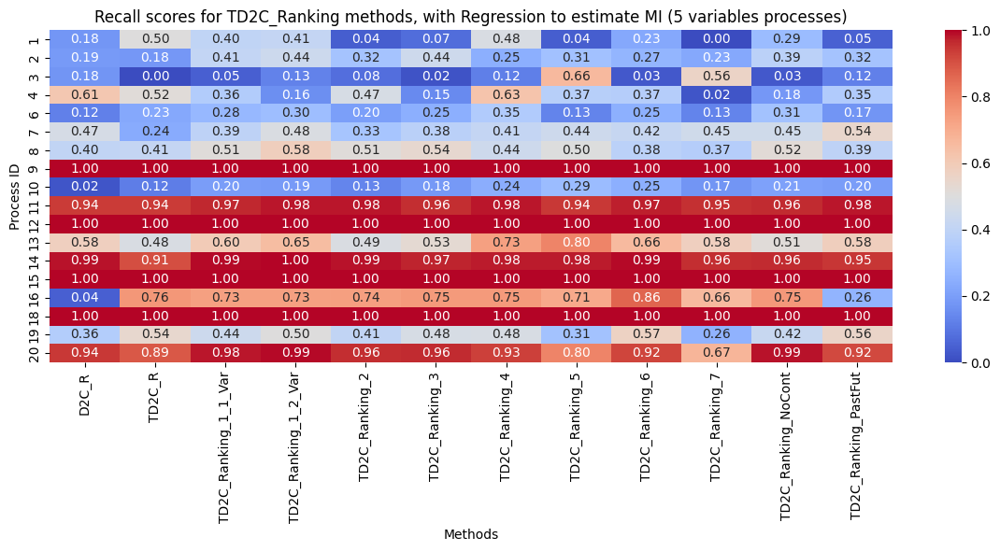

In [ ]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_heatmap_TD2C_Ranking.pdf')

plt.show()

In [ ]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'Recall'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,Recall
0,1,0.225356
1,2,0.312010
2,3,0.164091
3,4,0.349022
4,6,0.227555
5,7,0.417878
6,8,0.463066
7,9,1.000000
8,10,0.183748
9,11,0.963863


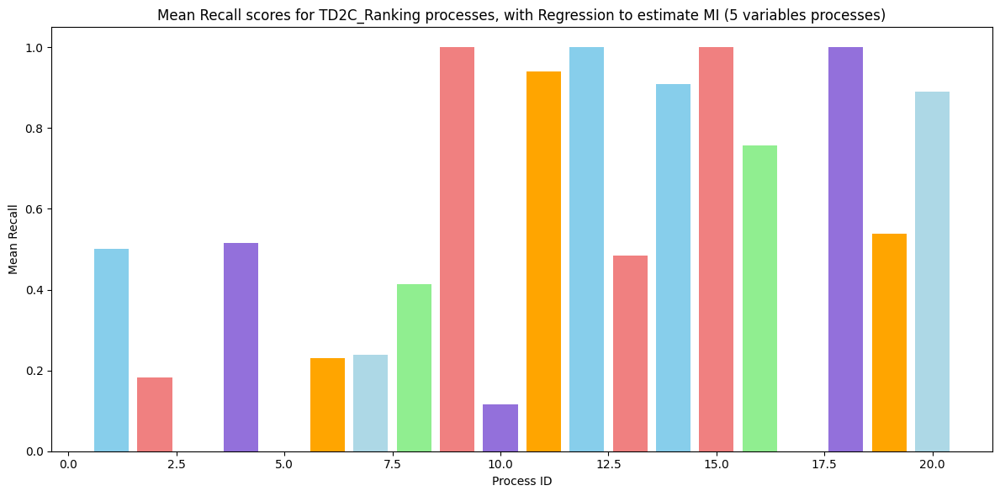

In [ ]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean Recall scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean Recall')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [ ]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'recall'})

df = df.sort_values(by='recall', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv', index=False)

df

,method,recall
1,TD2C_Ranking_4,0.654705
2,TD2C_Ranking_1_2_Var,0.641731
3,TD2C_Ranking_1_1_Var,0.627997
4,TD2C_Ranking_5,0.627104
5,TD2C_Ranking_6,0.620990
6,TD2C_Ranking_NoCont,0.609569
7,TD2C_R,0.595322
8,TD2C_Ranking_3,0.593743
9,TD2C_Ranking_2,0.591259
10,TD2C_Ranking_PastFut,0.577501


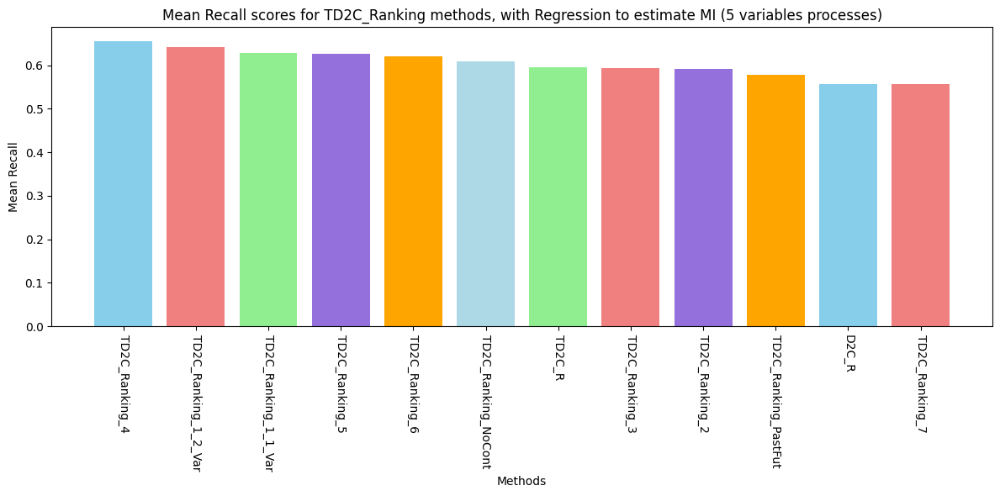

In [ ]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/recall_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['recall'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean Recall scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean Recall')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/recall_barplot_TD2C_Ranking_avg.pdf')

plt.show()

### F1

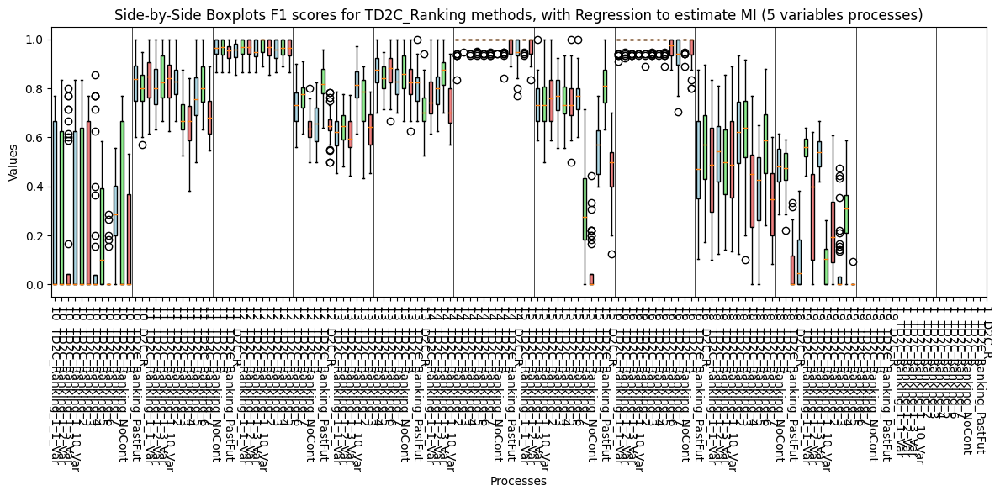

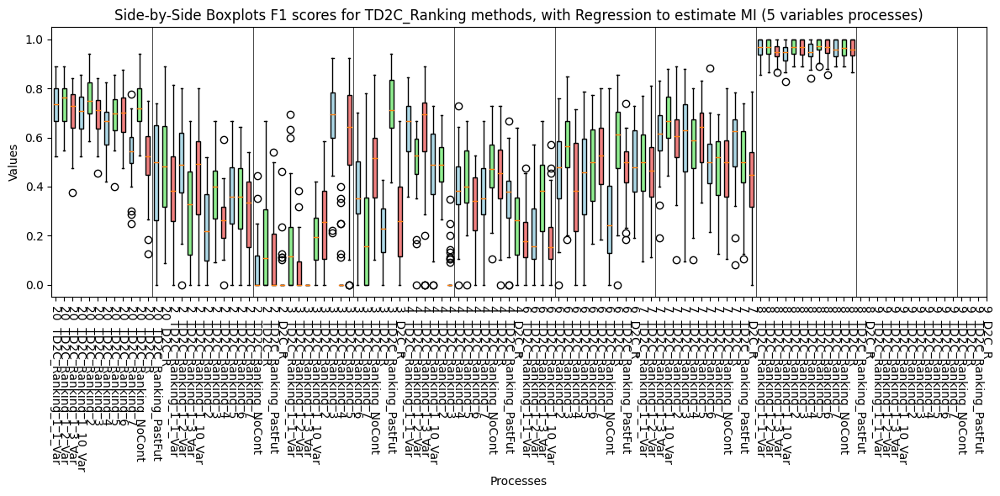

In [ ]:
# COMMENT OUT THE ONES YOU DIDN'T RUN
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)

# Processes 1-9

# Combine data for boxplot
combined_data = []

# Use the first 9 columns (processes)
for col in df5.columns[:10]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[:10]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_boxplot_TD2C_Ranking_1:9.pdf')

plt.show()

# Processes 10-20

combined_data = []

# Use the next 9 columns (processes)
for col in df5.columns[10:18]:
    combined_data.append(df1[col])
    combined_data.append(df2[col])
    # combined_data.append(df3[col])
    # combined_data.append(df4[col])
    combined_data.append(df5[col])
    combined_data.append(df6[col])
    combined_data.append(df11[col])
    combined_data.append(df7[col])
    combined_data.append(df8[col])
    combined_data.append(df9[col])
    combined_data.append(df10[col])
    combined_data.append(df12[col])
    combined_data.append(df13[col])
    combined_data.append(df14[col])

# Create labels for x-axis
labels = []
for col in df1.columns[10:18]:
    labels.append(f'{col}  TD2C_Ranking_1_1_Var')
    labels.append(f'{col}  TD2C_Ranking_1_2_Var')
    labels.append(f'{col}  TD2C_Ranking_1_3_Var')
    labels.append(f'{col}  TD2C_Ranking_1_10_Var')
    labels.append(f'{col}  TD2C_Ranking_2')
    labels.append(f'{col}  TD2C_Ranking_3')
    labels.append(f'{col}  TD2C_Ranking_4')
    labels.append(f'{col}  TD2C_Ranking_5')
    labels.append(f'{col}  TD2C_Ranking_6')
    labels.append(f'{col}  TD2C_Ranking_7')
    labels.append(f'{col}  TD2C_Ranking_NoCont')
    labels.append(f'{col}  TD2C_R')
    labels.append(f'{col}  TD2C_Ranking_PastFut')
    labels.append(f'{col}  D2C_R')

# Plotting Boxplot
plt.figure(figsize=(12, 6))
box = plt.boxplot(combined_data, patch_artist=True)

# Color customization
colors = ['lightblue', 'lightgreen', 'lightcoral'] #, 'lightyellow']
for patch, i in zip(box['boxes'], range(len(box['boxes']))):
    patch.set_facecolor(colors[i % 3])

plt.xticks(range(1, len(labels) + 1), labels, rotation=-90)
plt.title('Side-by-Side Boxplots F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Values')
plt.tight_layout()

# Add a vertical line every 6 boxes
for i in range(12, len(labels), 12):
    plt.axvline(x=i + 0.5, color='black', linewidth=0.5)

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_boxplot_TD2C_Ranking_10:20.pdf')

plt.show()

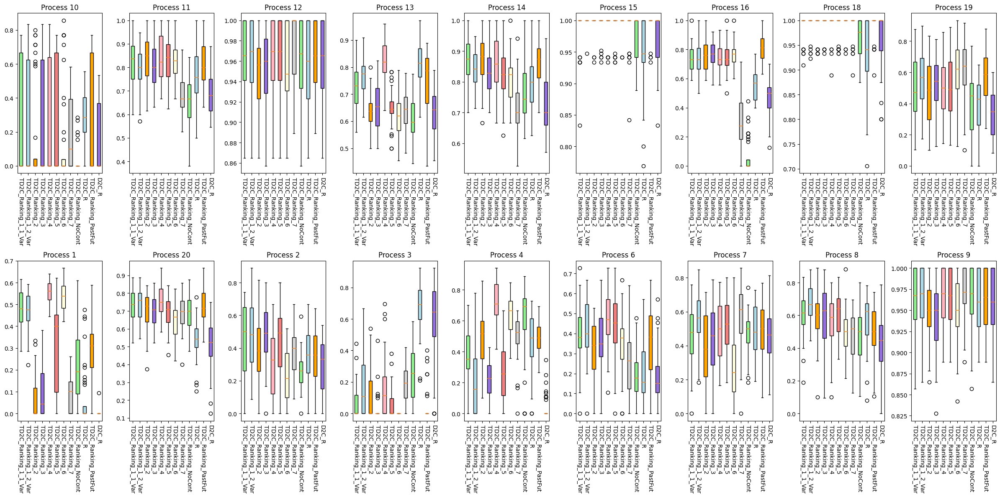

In [ ]:
# ANOTHER VISUALIZATION OF THE SAME PLOT

df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)


# Colors to match the provided image more closely
colors = ['lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral', 'lightyellow', 'lightgrey', 'lightgreen', 'lightblue', 'orange', 'mediumpurple', 'lightpink', 'lightcoral']

# Determine the number of processes (columns)
num_columns = len(df5.columns)

# Calculate the number of rows and columns for subplots
num_rows = 2  # 3 rows
num_cols = 9  # 6 plots per row

# Plotting Boxplot for Processes
fig, axes = plt.subplots(num_rows, num_cols, figsize=(24, 12))  # Adjust figsize as needed
axes = axes.flatten()

# Iterate over the columns in sequential order
for i, col in enumerate(df5.columns):
    data = [
        df1[col], df2[col], df5[col], df6[col], df11[col], df7[col], df8[col], df9[col], df10[col], df12[col], df13[col], df14[col]
    ]
    
    box = axes[i].boxplot(data, patch_artist=True)
    
    # Set colors for each box
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)
    
    axes[i].set_title(f'Process {col}')
    axes[i].set_xticklabels([
        'TD2C_Ranking_1_1_Var', 'TD2C_Ranking_1_2_Var', 'TD2C_Ranking_2', 'TD2C_Ranking_3', 'TD2C_Ranking_4', 'TD2C_Ranking_5', 'TD2C_Ranking_6', 'TD2C_Ranking_7', 'TD2C_Ranking_NoCont', 'TD2C_R', 'TD2C_Ranking_PastFut', 'D2C_R'
    ], rotation=-90)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_boxplot_TD2C_Ranking_best_vs_TD2C.pdf')
plt.show()



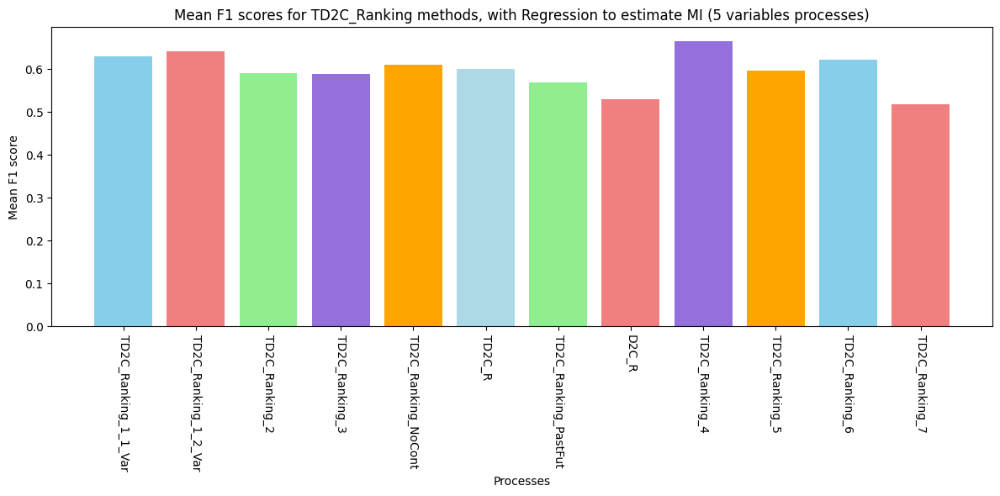

In [ ]:
# Define the DataFrames
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)


# Calculate the means
means = [
    df1.mean().mean(),
    df2.mean().mean(),
    df5.mean().mean(),
    df6.mean().mean(),
    df7.mean().mean(),
    df8.mean().mean(),
    df9.mean().mean(),
    df10.mean().mean(),
    df11.mean().mean(),
    df12.mean().mean(),
    df13.mean().mean(),
    df14.mean().mean()
]

# Define the labels
labels = [
    'TD2C_Ranking_1_1_Var',
    'TD2C_Ranking_1_2_Var',
    'TD2C_Ranking_2',
    'TD2C_Ranking_3',
    'TD2C_Ranking_NoCont',
    'TD2C_R',
    'TD2C_Ranking_PastFut',
    'D2C_R',
    'TD2C_Ranking_4',
    'TD2C_Ranking_5',
    'TD2C_Ranking_6',
    'TD2C_Ranking_7'
]

# Define the colors
colors = ['skyblue', 'lightcoral', 'lightgreen', 'mediumpurple', 'orange', 'lightblue', 'lightgreen', 'lightcoral', 'mediumpurple', 'orange', 'skyblue', 'lightcoral']

# Barplot the mean of the ROC-AUC scores
plt.figure(figsize=(12, 6))
plt.bar(labels, means, color=colors)
plt.xticks(rotation=-90)
plt.title('Mean F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Processes')
plt.ylabel('Mean F1 score')
plt.tight_layout()

# Save the plot as a pdf in folder (optional)
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_barplot_TD2C_Ranking_best_vs_TD2C.pdf')

plt.show()


In [ ]:
# NOW SHOW THE ROUC-AUC RESULTS IN A DATAFRAME DOING THE AVERAGES FOR EACH PROCESS FOR EACH METHOD
df1 = pd.DataFrame(TD2C_Ranking_1_1_Var_f1_process)
df2 = pd.DataFrame(TD2C_Ranking_1_2_Var_f1_process)
# df3 = pd.DataFrame(TD2C_Ranking_1_3_Var_f1_process)
# df4 = pd.DataFrame(TD2C_Ranking_1_10_Var_f1_process)
df5 = pd.DataFrame(TD2C_Ranking_2_f1_process)
df6 = pd.DataFrame(TD2C_Ranking_3_f1_process)
df7 = pd.DataFrame(TD2C_Ranking_NoCont_f1_process)
df8 = pd.DataFrame(TD2C_f1_process)
df9 = pd.DataFrame(TD2C_Ranking_PastFut_f1_process)
df10 = pd.DataFrame(D2C_f1_process)
df11 = pd.DataFrame(TD2C_Ranking_4_f1_process)
df12 = pd.DataFrame(TD2C_Ranking_5_f1_process)
df13 = pd.DataFrame(TD2C_Ranking_6_f1_process)
df14 = pd.DataFrame(TD2C_Ranking_7_f1_process)

df1 = df1.T
df2 = df2.T
# df3 = df3.T
# df4 = df4.T
df5 = df5.T
df6 = df6.T
df7 = df7.T
df8 = df8.T
df9 = df9.T
df10 = df10.T
df11 = df11.T
df12 = df12.T
df13 = df13.T
df14 = df14.T

df1['method'] = 'TD2C_Ranking_1_1_Var'
df2['method'] = 'TD2C_Ranking_1_2_Var'
# df3['method'] = 'TD2C_Ranking_1_3_Var'
# df4['method'] = 'TD2C_Ranking_1_10_Var'
df5['method'] = 'TD2C_Ranking_2'
df6['method'] = 'TD2C_Ranking_3'
df11['method'] = 'TD2C_Ranking_4'
df12['method'] = 'TD2C_Ranking_5'
df13['method'] = 'TD2C_Ranking_6'
df14['method'] = 'TD2C_Ranking_7'
df7['method'] = 'TD2C_Ranking_NoCont'
df8['method'] = 'TD2C_R'
df9['method'] = 'TD2C_Ranking_PastFut'
df10['method'] = 'D2C_R'

df = pd.concat([df1, df2, df5, df6, df11, df7, df12, df13, df14, df8, df9, df10]) # , df3, df4

df = df.reset_index()
df = df.rename(columns={'index': 'process_id'})

df = df.melt(id_vars=['process_id', 'method'], var_name='graph_id', value_name='F1')

df['F1'] = df['F1'].astype(float)

df = df.groupby(['process_id', 'method']).mean().reset_index()

df = df.pivot(index='process_id', columns='method', values='F1')

df = df.reset_index()

df = df.rename(columns={'process_id': 'Process ID', 
                        'TD2C_+Ranking_1_1_Var_f1_process': 'TD2C_+Ranking_1_1_Var_f1_process',
                        'TD2C_+Ranking_1_2_Var_f1_process': 'TD2C_+Ranking_1_2_Var_f1_process',
                        # 'TD2C_+Ranking_1_3_Var_f1_process': 'TD2C_+Ranking_1_3_Var_f1_process',
                        # 'TD2C_+Ranking_1_10_Var_f1_process': 'TD2C_+Ranking_1_10_Var_f1_process',
                        'TD2C_+Ranking_2_f1_process': 'TD2C_+Ranking_2_f1_process',
                        'TD2C_+Ranking_3_f1_process': 'TD2C_+Ranking_3_f1_process',
                        'TD2C_+Ranking_4_f1_process': 'TD2C_+Ranking_4_f1_process',
                        'TD2C_+Ranking_NoCont_f1_process': 'TD2C_+Ranking_NoCont_f1_process',
                        'TD2C_R_f1_process': 'TD2C_R_f1_process',
                        'TD2C_+Ranking_PastFut_f1_process': 'TD2C_+Ranking_PastFut_f1_process',
                        'D2C_R_f1_process': 'D2C_R_f1_process'})


# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv', index=False)

df

/tmp/ipykernel_60267/2778043241.py:56: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df = df.groupby(['process_id', 'method']).mean().reset_index()


method,Process ID,D2C_R,TD2C_R,TD2C_Ranking_1_1_Var,TD2C_Ranking_1_2_Var,TD2C_Ranking_2,TD2C_Ranking_3,TD2C_Ranking_4,TD2C_Ranking_5,TD2C_Ranking_6,TD2C_Ranking_7,TD2C_Ranking_NoCont,TD2C_Ranking_PastFut
0,1,0.216095,0.540865,0.482644,0.473677,0.061805,0.096058,0.555821,0.068445,0.302626,0.002381,0.308374,0.084419
1,2,0.259610,0.230352,0.439626,0.474047,0.361127,0.483096,0.312075,0.360734,0.337093,0.287394,0.427434,0.383449
2,3,0.247944,0.000000,0.075926,0.185582,0.112680,0.028601,0.176099,0.678931,0.045560,0.579416,0.048129,0.184577
3,4,0.610825,0.630310,0.375039,0.212884,0.501464,0.226886,0.712946,0.458028,0.484274,0.037164,0.258850,0.498363
4,6,0.193081,0.349930,0.397389,0.417802,0.309509,0.364571,0.483882,0.193801,0.355961,0.190893,0.435177,0.259939
5,7,0.479637,0.295407,0.462670,0.555141,0.395062,0.433053,0.489928,0.482162,0.485824,0.458613,0.517075,0.570894
6,8,0.480524,0.497574,0.604253,0.670576,0.586697,0.590041,0.554045,0.569643,0.490520,0.427806,0.600025,0.480915
7,9,0.963947,0.950398,0.959826,0.963590,0.952231,0.945386,0.964492,0.957382,0.961551,0.955288,0.961853,0.973255
8,10,0.027201,0.140540,0.225435,0.214274,0.160100,0.203636,0.263499,0.289166,0.261994,0.149238,0.236139,0.195643
9,11,0.650531,0.819603,0.817711,0.797829,0.838343,0.808224,0.836857,0.762696,0.805068,0.685602,0.836233,0.683880


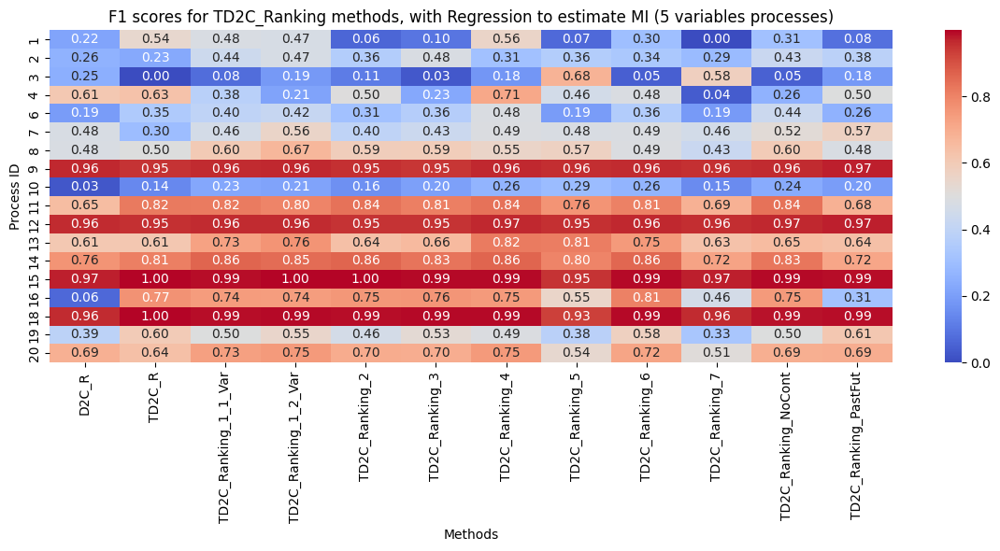

In [ ]:
import seaborn as sns

# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

# Plot the dataframe as a heatmap
df = df.set_index('Process ID')

plt.figure(figsize=(12, 6))
sns.heatmap(df, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Process ID')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_heatmap_TD2C_Ranking.pdf')

plt.show()

In [ ]:
# now average each row of the dataframe
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

df = df.set_index('Process ID')

df = df.mean(axis=1)

df = df.reset_index()

df = df.rename(columns={0: 'F1'})

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_mean_proc.csv', index=False)

df

,Process ID,F1
0,1,0.266101
1,2,0.363003
2,3,0.196954
3,4,0.417253
4,6,0.329328
5,7,0.468789
6,8,0.546052
7,9,0.959100
8,10,0.197239
9,11,0.778548


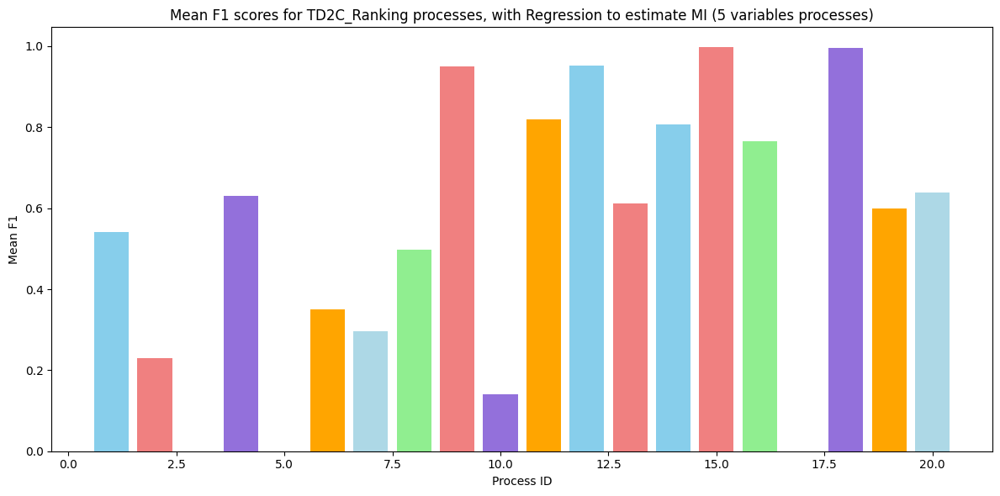

In [ ]:
# Load the DataFrame
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

# Strip any leading/trailing spaces from column names
df.columns = df.columns.str.strip()

# Plot the DataFrame as a barplot
plt.figure(figsize=(12, 6))
plt.bar(df['Process ID'], df['TD2C_R'], color=colors)
plt.title('Mean F1 scores for TD2C_Ranking processes, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Process ID')
plt.ylabel('Mean F1')
plt.tight_layout()

# Save the plot as a PDF in the folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_barplot_TD2C_Ranking_mean_proc.pdf')

plt.show()

In [ ]:
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking.csv')

# now average the results for each process
df = df.mean()

df = df.reset_index()

df = df.rename(columns={'index': 'method', 0: 'f1'})

df = df.sort_values(by='f1', ascending=False)

df = df.reset_index(drop=True)

# drop Process ID 0 row
df = df.drop(0)

# save the dataframe to a csv file to folder
df.to_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv', index=False)

df

,method,f1
1,TD2C_Ranking_4,0.664577
2,TD2C_Ranking_1_2_Var,0.642530
3,TD2C_Ranking_1_1_Var,0.630039
4,TD2C_Ranking_6,0.621813
5,TD2C_Ranking_NoCont,0.610467
6,TD2C_R,0.601356
7,TD2C_Ranking_5,0.596607
8,TD2C_Ranking_2,0.590697
9,TD2C_Ranking_3,0.588289
10,TD2C_Ranking_PastFut,0.568871


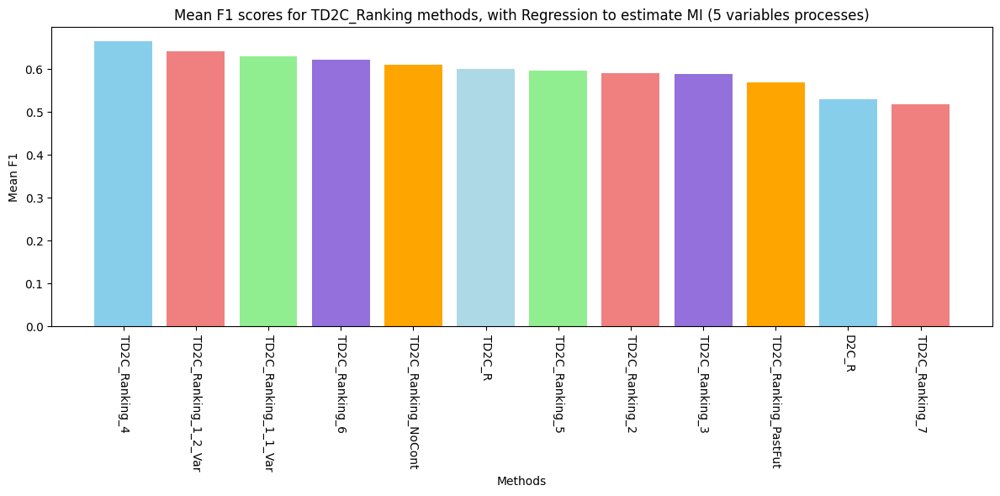

In [ ]:
# load the dataframe from the csv file
df = pd.read_csv('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/metrics/f1_td2c_ranking_avg.csv')

# Plotting Barplot for methods for indexes 1 to 6
plt.figure(figsize=(12, 6))
plt.bar(df['method'], df['f1'], color=colors)
plt.xticks(rotation=-90)
plt.title('Mean F1 scores for TD2C_Ranking methods, with Regression to estimate MI (5 variables processes)')
plt.xlabel('Methods')
plt.ylabel('Mean F1')
plt.tight_layout()

# save the plot as a pdf in folder
plt.savefig('/home/jpalombarini/td2c/notebooks/contributions/td2c_extesions/results/Regression/plots/f1_barplot_TD2C_Ranking_avg.pdf')

plt.show()